# he de cambiar

- automatizar path test image

- Modify in the code:
    - path test image
    - YMD test image
    - vmin vmax colormap prediction errors

# Inputs

- Info to track record about each experiment

In [123]:
date = '22-03-2021'
name = 'basic' #default=basic
description = '''
See why clouds are well reconstructed but show error. Our hypotesis is that bands bad reconstructed are no visible ones.
In Branau the training data we have is few and bad quality. That's why I select 100 pixels per cluster for training and 100 for testing.
I do another clustering over the testing image to detect pixel positions where are clouds.
'''

- Technical inputs

In [3]:
area = 'Branau'
path_images = f'/home/boku/autoencoders/images/{area}/'
bands = ['B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B10', 'B11', 'B12']
directory = 'experiment' #updated, experiment or tuning
experiment_name = 'cloud-reflectances'
n_pixels = 100
n_clusters = 8
n_hidden_neurons = 10
no_hazzy_images = False

- During the notebook: not forget to determine the cloudy cluster

# Libraries

In [ ]:
'''Main'''
import numpy as np
import pandas as pd
import os, time, re
import pickle, gzip
from random import randint
import math
import re
import random

'''Data Viz'''
import matplotlib.pyplot as plt
from matplotlib.pyplot import hist
import matplotlib.cm as cm
import seaborn as sns
color = sns.color_palette()
import matplotlib as mpl

%matplotlib inline

'''Data Prep and Model Evaluation'''
from sklearn import preprocessing as pp
from sklearn.metrics import mean_squared_error
from sklearn.cluster import KMeans
from sklearn.neighbors import NearestNeighbors
from sklearn.model_selection import train_test_split 
from sklearn.model_selection import StratifiedKFold 
from sklearn.metrics import log_loss
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.metrics import roc_curve, auc, roc_auc_score
import joblib 

'''Algos'''
#import lightgbm as lgb

'''TensorFlow and Keras'''
import tensorflow as tf
import keras
from keras import backend as K
from keras.models import Sequential, Model, load_model
from keras.layers import Activation, Dense, Dropout
from keras.layers import BatchNormalization, Input, Lambda
from keras import regularizers
from keras.losses import mse, binary_crossentropy

from osgeo import gdal
from osgeo import gdal_array
import matplotlib.pyplot as plt
import numpy as np
import sys
from osgeo.gdalconst import *
import os

import math
import codecs

import osgeo #this is necessary for the type comparison in some methods
from osgeo import osr
from osgeo import ogr
from collections import defaultdict
import itertools
from osgeo import gdal_array as gdar
from osgeo import gdalconst as gdct
import glob

# Directories and info

- Directories

In [4]:
# path -- Experiment
experiment_filepath = f'/home/boku/autoencoders/codes/{directory}/{experiment_name}/'
if not os.path.exists(experiment_filepath):
    os.mkdir(experiment_filepath)

# path -- Area
area_filepath = f'{experiment_filepath}/{area}/'
if not os.path.exists(area_filepath):
    os.mkdir(area_filepath)

# path -- Name
filepath = f'{area_filepath}/{name}/'
if not os.path.exists(filepath):
    os.mkdir(filepath)

# path -- Models
model_filepath = os.path.join(filepath, 'Models/')
if not os.path.exists(model_filepath):
    os.mkdir(model_filepath)

# path -- Figures
figures_filepath = os.path.join(filepath, 'Figures/')
if not os.path.exists(figures_filepath):
    os.mkdir(figures_filepath)

# path -- Scalers
scalers = os.path.join(model_filepath, 'Scalers/')
if not os.path.exists(scalers):
    os.mkdir(scalers)

- Info

In [124]:
text = f'''
This folder contains the code, autoencoder models and figures resulting from the application of autoencoders in the area of {area}.

DATE: {date} (last modification)

DETAILS:
- Area of study: {area}
- Name (or objective): {name}
- Without hazzy images: {no_hazzy_images}
- Number of clusters: {n_clusters}
- Number of training pixels per cluster: {n_pixels}
- Random testing: True
- Number of hidden layers: 1
- Number of neurons in hidden layers: {n_hidden_neurons}
- Optimizer: Adam
- Learning rate: 0.01
- Activation function: linear

DESCRIPTION
{description}
'''

In [125]:
with open(f"{filepath}README.txt", "w") as file:
    file.write(text)

# Functions

In [7]:
def is_leap_year(year):
    """ if year is a leap year return True
        else return False """
    if year % 100 == 0:
        return year % 400 == 0
    return year % 4 == 0

def doy(Y,M,D):
    """ given year, month, day return day of year
        Astronomical Algorithms, Jean Meeus, 2d ed, 1998, chap 7 """
    if is_leap_year(Y):
        K = 1
    else:
        K = 2
    N = int((275 * M) / 9.0) - K * int((M + 9) / 12.0) + D - 30
    return N
def scale_MinMax (array, model_filepath, scaler_name):
    
    # Create scaler and scale
    scaler = pp.MinMaxScaler()
    array_scaled = scaler.fit_transform(array)
    
    #Create new folder and save
    mf_scaler = os.path.join(model_filepath, scaler_name)
    if not os.path.exists(mf_scaler):
        os.mkdir(mf_scaler) 
    
    joblib.dump(scaler, mf_scaler + '/scale.mod')
    
    return array_scaled

# Data from .tif images

**Train**

In [8]:
#Train
training = []
ymds = []
doys = []

files = sorted(os.listdir(path_images))
for f in files:
    if not f.startswith(('.', 'm')) and f.endswith(('.tif')) and os.path.isfile(os.path.join(path_images, f)):
        # Bands: delete cloud band and B10
        tif = gdal_array.LoadFile(path_images+f)
        if ['Cloud', 'cloud', 'CLOUD'] in bands:
            tif = np.delete(tif, 0, axis=0)
        if 'B10' in bands:
            tif = np.delete(tif, 10, axis=0)
        
        # DOY: t1, t2
        Y_M_D = re.sub("[^0-9]", "", f)
        ymds.append(Y_M_D)
        d = doy(int(Y_M_D[-4:]),int(Y_M_D[2:4]),int(Y_M_D[:2]))
        doys.append(d)
        t1 = np.full((tif.shape[1], tif.shape[2]), (np.sin(d*2*np.pi/365)+1)/2)
        t2 = np.full((tif.shape[1], tif.shape[2]), (np.cos(d*2*np.pi/365)+1)/2)
        t1_t2 = np.stack([t1, t2], axis=0)
        
        # Join
        tif = np.concatenate([tif, t1_t2], axis=0)
        print(f'.tif shape: {tif.shape}')
        training.append(tif)

training = np.stack(training, axis = 0)

print(f'''-> Files:
{files}''')
print(f'-> Dates: {ymds}')
print(f'-> DOYs: {doys}')
print(f'-> tifArray shape: {training.shape}')

.tif shape: (14, 348, 777)
.tif shape: (14, 348, 777)
.tif shape: (14, 348, 777)
.tif shape: (14, 348, 777)
-> Files:
['Branau_clean_Image_20150803.tif', 'Branau_clean_Image_20150803.tif.aux.xml', 'Branau_clean_Image_20151012.tif.aux.xml', 'Branau_clean_Image_20160130.tif', 'Branau_clean_Image_20160130.tif.aux.xml', 'Branau_clean_Image_20160429.tif', 'Branau_clean_Image_20160429.tif.aux.xml', 'Branau_clean_Image_20160509.tif', 'Branau_clean_Image_20160509.tif.aux.xml', 'Movida', 'Old_mask', 'Test', 'mask_Branau.tif', 'mask_Branau.tif.aux.xml', '~$ta_info.docx']
-> Dates: ['20150803', '20160130', '20160429', '20160509']
-> DOYs: [444, 474, 474, 474]
-> tifArray shape: (4, 14, 348, 777)


**Test**

In [9]:
#ATENCIÓN:
#Test (tiene diferente shape por eso lo hago a parte, de normal las cargaría todas juntas y después dividiría train y test)

# Bands: delete cloud band and B10
tif = gdal_array.LoadFile(f'/home/boku/autoencoders/images/{area}/Test/Branau_clean_Image_20160618.tif')
if ['Cloud', 'cloud', 'CLOUD'] in bands:
    tif = np.delete(tif, 0, axis=0)
if 'B10' in bands:
    tif = np.delete(tif, 10, axis=0)

# DOY: t1, t2
Y_M_D = '20160618'
d = doy(int(Y_M_D[-4:]),int(Y_M_D[2:4]),int(Y_M_D[:2]))
print(f'DOY: {d}')
t1 = np.full((tif.shape[1], tif.shape[2]), (np.sin(d*2*np.pi/365)+1)/2)
t2 = np.full((tif.shape[1], tif.shape[2]), (np.cos(d*2*np.pi/365)+1)/2)
t1_t2 = np.stack([t1, t2], axis=0)

# Join
testing = np.concatenate([tif, t1_t2], axis=0)
testing.shape

DOY: 474


(14, 348, 777)

**Bands**

In [10]:
bands = ['B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B11', 'B12', 't1', 't2']

# Image selection

In [11]:
if no_hazzy_images:
    # Delete images
    img_cloud = [4, 12, 17, 19, 22, 30, 34, 36, 42]
    training = np.delete(training, img_cloud, axis=0)
    shape=training.shape
    print(f'shape: {shape}')
    doys = list(np.delete(np.array(doys), img_cloud, axis = 0))
    ymds = list(np.delete(np.array(ymds), img_cloud, axis = 0))
    len(f'len doys: {doys}')
    len(f'len ymds: {ymds}')

# Show data

**True color composite**

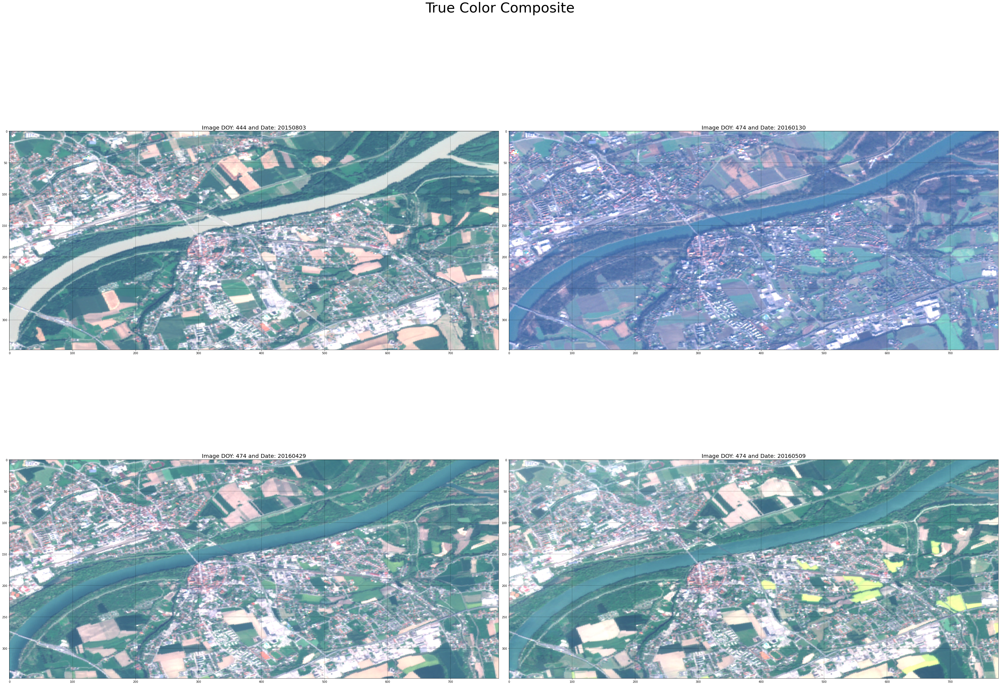

In [12]:
# Fill in number of figures:
n_figures = training.shape[0]

# Prepare subplots
n_rows = int(math.ceil((n_figures)**(1/2)))
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'True Color Composite', fontsize = 50)

# Plot images
for sp in range(n_figures):
    image = training[sp]
    img = np.dstack((image[3, ...]/1500, image[2, ...]/1500, image[1, ...]/1500))
    img = np.clip(img, 0, 1)
    ax = axs[rows[sp], columns[sp]]
    img = ax.imshow(np.array(img))
    ax.grid(color='black', linewidth=0.3)
    ax.set_title(f'Image DOY: {doys[sp]} and Date: {ymds[sp]}', fontsize=20)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# save
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/original_images.png', format='png', dpi=50)
plt.show()

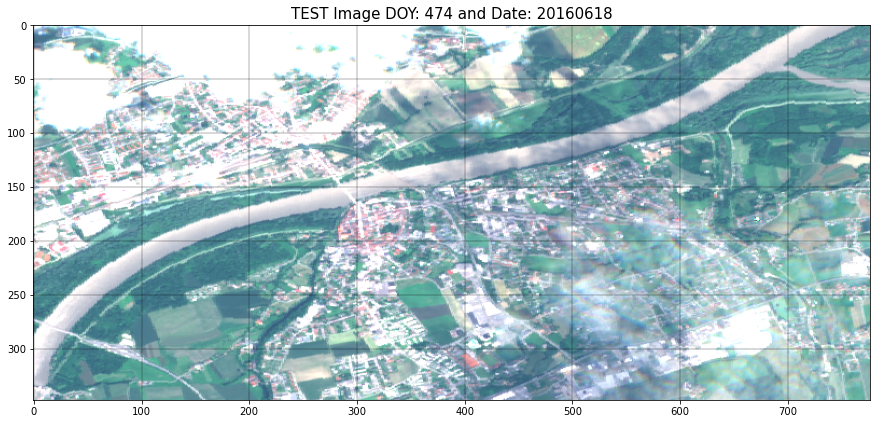

In [13]:
plt.figure(figsize = (15,15))
image = testing
img = np.dstack((image[3, ...]/1500, image[2, ...]/1500, image[1, ...]/1500))
img = np.clip(img, 0, 1)
plt.imshow(np.array(img))
plt.grid(color='black', linewidth=0.3)
plt.title(f'TEST Image DOY: {d} and Date: {Y_M_D}', fontsize=15)
plt.savefig(f'{figures_filepath}/original_images_flood.png', format='png', dpi=300)
plt.show()

# Prepare data for Clustering and AE

**CLUSTERING**

In [14]:
array_kmeans = training[:,:-2, :,:]
array_kmeans = np.transpose(array_kmeans.reshape(array_kmeans.shape[0]*array_kmeans.shape[1], array_kmeans.shape[2]*array_kmeans.shape[3]))
array_kmeans.shape

(270396, 48)

**CLUSTERING TESTING**: to detect cloud positions

In [55]:
array_kmeans_testing = testing[:-2, :,:]
array_kmeans_testing = np.transpose(array_kmeans_testing.reshape(array_kmeans_testing.shape[0], array_kmeans_testing.shape[1]*array_kmeans_testing.shape[2]))
array_kmeans.shape

(270396, 48)

**TRAINING RESHAPED FOR AUTOENCODER**

In [15]:
# Reshape: images, bands, rows*columns
train_AE = training.reshape(training.shape[0], training.shape[1], training.shape[2]*training.shape[3])
# Join per images: bands, images*rows*columns
train_AE = np.concatenate(train_AE, axis=1)
# Transpose: images*rows*columns, bands
train_AE = train_AE.transpose()
train_AE.shape

(1081584, 14)

**TESTING RESHAPED FOR AUTOENCODER**

In [16]:
# Reshape: images, bands, rows*columns
test_AE = testing.reshape(testing.shape[0], testing.shape[1]*testing.shape[2])
# Transpose: images*rows*columns, bands
test_AE = test_AE.transpose()
test_AE.shape

(270396, 14)

# Clustering

In [96]:
# Train K-means
n_features = array_kmeans.shape[1]
print('Training the algorithm...')
start = time.time()
means = KMeans(n_clusters=n_clusters, n_init = 20, random_state = 1996).fit(array_kmeans)
end = time.time()
print(f'--- minutes ---- {(end - start)/60}')

Training the algorithm...
--- minutes ---- 0.20490020116170246


In [97]:
labels = means.labels_.reshape(training.shape[2], training.shape[3])

<Figure size 432x288 with 0 Axes>

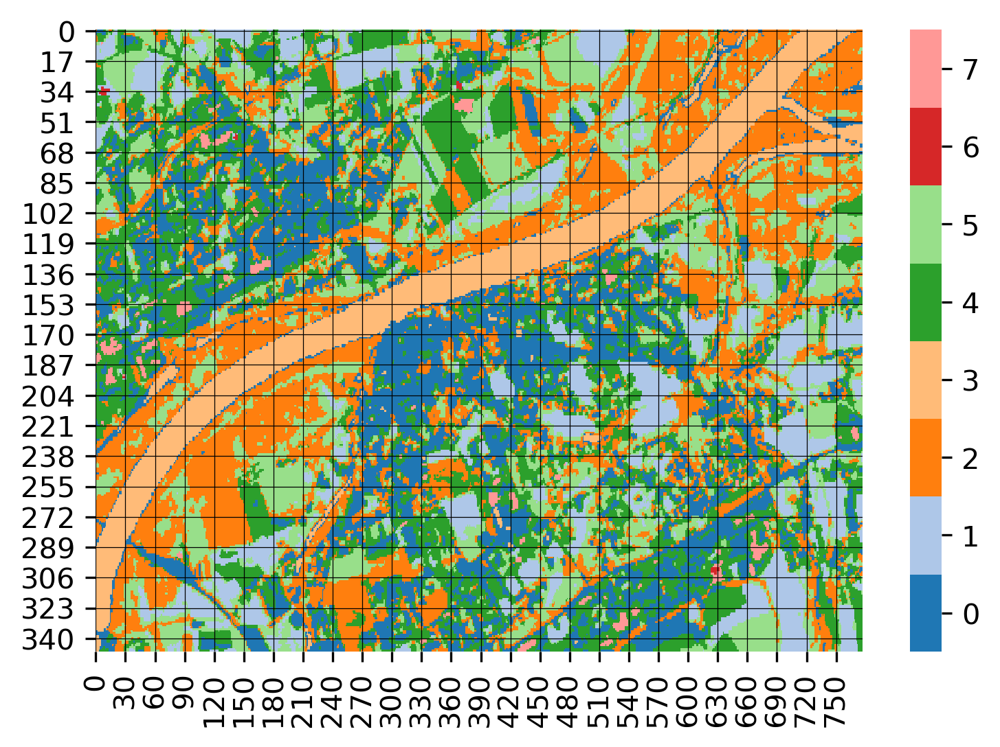

In [98]:
plt.figure()
# discrete colormap (n samples from a given cmap)
cmap = sns.color_palette('tab20', n_clusters) 
fig, ax = plt.subplots(dpi=300) 
ax = sns.heatmap(labels, cmap=cmap) 
# modify colorbar:
colorbar = ax.collections[0].colorbar 
r = colorbar.vmax - colorbar.vmin 
colorbar.set_ticks([colorbar.vmin + r / n_clusters * (0.5 + i) for i in range(n_clusters)])
colorbar.set_ticklabels(list(range(n_clusters)))
plt.grid(color='black', linewidth=0.3)
plt.savefig(f'{figures_filepath}/clusters.png', format='png', dpi=300)
plt.show()

**TRUE COLOR COMPOSITE BY CLUSTERS**

In [20]:
'''plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Positions Clusters', fontsize = 70)

# Pixels training positions for the cluster
for sp in range(n_figures):
    cluster = labels==sp
    ax = axs[rows[sp], columns[sp]]
    image = testing
    img = np.dstack((image[3, ...]/1500, image[2, ...]/1500, image[1, ...]/1500))
    img = np.clip(img, 0, 1)
    img = ax.imshow(img)
    ax.contour(cluster, colors='red', linewidths=1.5)
    ax.set_xticks(np.arange(cluster.shape[1]+1, step=100))
    ax.set_yticks(np.arange(cluster.shape[0]+1, step=100))
    ax.set_title(f'Cluster {sp}', fontsize=50)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/clusters_TCC.png', format='png', dpi=300)
plt.show()'''

"plt.figure()\n# Prepare subplots\nn_figures = n_clusters\nn_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar\nn_cols = int(math.ceil(n_figures/n_rows))\nrows=[]\ncolumns = []\nfor row in range(n_rows):\n    for col in range(n_cols):\n        rows.append(row)\n        columns.append(col)\n\n# Subplots and figure title\nfig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))\nfig.suptitle(f'Positions Clusters', fontsize = 70)\n\n# Pixels training positions for the cluster\nfor sp in range(n_figures):\n    cluster = labels==sp\n    ax = axs[rows[sp], columns[sp]]\n    image = testing\n    img = np.dstack((image[3, ...]/1500, image[2, ...]/1500, image[1, ...]/1500))\n    img = np.clip(img, 0, 1)\n    img = ax.imshow(img)\n    ax.contour(cluster, colors='red', linewidths=1.5)\n    ax.set_xticks(np.arange(cluster.shape[1]+1, step=100))\n    ax.set_yticks(np.arange(cluster.shape[0]+1, step=100))\n    ax.set_title(f'Cluster {sp}', fontsize=50)\n\n# 

**DIFFERENCES BETWEEN CLUSTERS**

- Function to get the positions of all pixels differenciated by their cluster

In [21]:
allClusters_pixels = []
for cluster in range(n_clusters):
    cluster = labels == cluster
    result=np.where(cluster)
    pixels = list(zip(result[0], result[1]))
    allClusters_pixels.append(pixels)
print(f'len:{len(allClusters_pixels)}')

len:8


- Get data per cluster and represent

In [22]:
'''#Fill in number of figures:
n_figures = training.shape[1]

#Prepare subplots
n_rows = int(math.ceil((n_figures)**(1/2)))
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

#Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Bands per Cluster', fontsize = 50)

##Plot random selection of pixels per band
for sp in range(n_figures):
    data = []
    label_data = []
    for cluster in range(n_clusters):
        data_cluster = []
        name = f'Cluster {cluster}'
        label_data.append(name)
        pixels = allClusters_pixels[cluster]
        for img in range(training.shape[0]):
            for pixel in pixels:
                pixel = training[img, sp, int(pixel[0]), int(pixel[1])]
                data_cluster.append(pixel)
        data.append(data_cluster)
    data = np.array(data, dtype=object)
    
    # Customize band plot
    ax = axs[rows[sp], columns[sp]]
    ax.boxplot(data.transpose())
    ax.set_title(f'Band: {bands[sp]}', fontsize=25)
    ax.set_xlabel('Cluster', fontsize=20)
    ax.set_ylabel('Reflectance', fontsize=20)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=20, width=3)
    plt.sca(axs[rows[sp], columns[sp]])
    plt.xticks(list(range(1,len(label_data)+1)), label_data, rotation='vertical')

#delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

#save
plt.tight_layout()
fig.subplots_adjust(top=0.99)
plt.savefig(f'{figures_filepath}/boxplots_clusters.png', format='png', dpi=300)
plt.show()'''

"#Fill in number of figures:\nn_figures = training.shape[1]\n\n#Prepare subplots\nn_rows = int(math.ceil((n_figures)**(1/2)))\nn_cols = int(math.ceil(n_figures/n_rows))\nrows=[]\ncolumns = []\nfor row in range(n_rows):\n    for col in range(n_cols):\n        rows.append(row)\n        columns.append(col)\n\n#Subplots and figure title\nfig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))\nfig.suptitle(f'Bands per Cluster', fontsize = 50)\n\n##Plot random selection of pixels per band\nfor sp in range(n_figures):\n    data = []\n    label_data = []\n    for cluster in range(n_clusters):\n        data_cluster = []\n        name = f'Cluster {cluster}'\n        label_data.append(name)\n        pixels = allClusters_pixels[cluster]\n        for img in range(training.shape[0]):\n            for pixel in pixels:\n                pixel = training[img, sp, int(pixel[0]), int(pixel[1])]\n                data_cluster.append(pixel)\n        data.append(data_cluster)\n    data = np.array(data, dty

# Clustering testing: get cloud pixels

In [109]:
# Train K-means
n_features = array_kmeans_testing.shape[0]
print('Training the algorithm...')
start = time.time()
cloudy_means = KMeans(n_clusters=n_clusters, n_init = 20, random_state = 1996).fit(array_kmeans_testing)
end = time.time()
print(f'--- minutes ---- {(end - start)/60}')

Training the algorithm...
--- minutes ---- 0.12620586554209393


In [117]:
cloudy_labels = cloudy_means.labels_.reshape(testing.shape[1], testing.shape[2])

<Figure size 432x288 with 0 Axes>

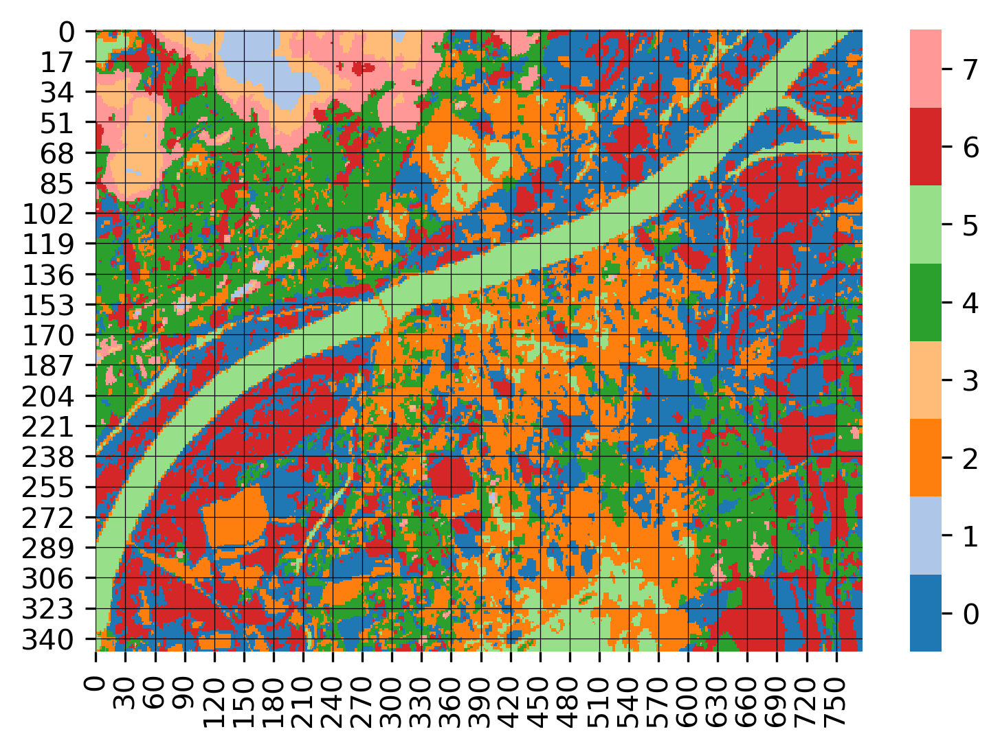

In [118]:
plt.figure()
# discrete colormap (n samples from a given cmap)
cmap = sns.color_palette('tab20', n_clusters) 
fig, ax = plt.subplots(dpi=300) 
ax = sns.heatmap(cloudy_labels, cmap=cmap) 
# modify colorbar:
colorbar = ax.collections[0].colorbar 
r = colorbar.vmax - colorbar.vmin 
colorbar.set_ticks([colorbar.vmin + r / n_clusters * (0.5 + i) for i in range(n_clusters)])
colorbar.set_ticklabels(list(range(n_clusters)))
plt.grid(color='black', linewidth=0.3)
plt.savefig(f'{figures_filepath}/clusters_testing.png', format='png', dpi=300)
plt.show()

- Positions of cloudy pixels

In [60]:
cloudy_cluster = 1

In [61]:
cloudy_cluster = labels == cloudy_cluster
cloudy_result=np.where(cloudy_cluster)
cloudy_pixels = list(zip(cloudy_result[0], cloudy_result[1]))

print(f'len:{len(cloudy_pixels)}')

len:3078


# Get training and testing pixels

- **Training: by representativity**

Shape: (348, 777)


<Figure size 432x288 with 0 Axes>

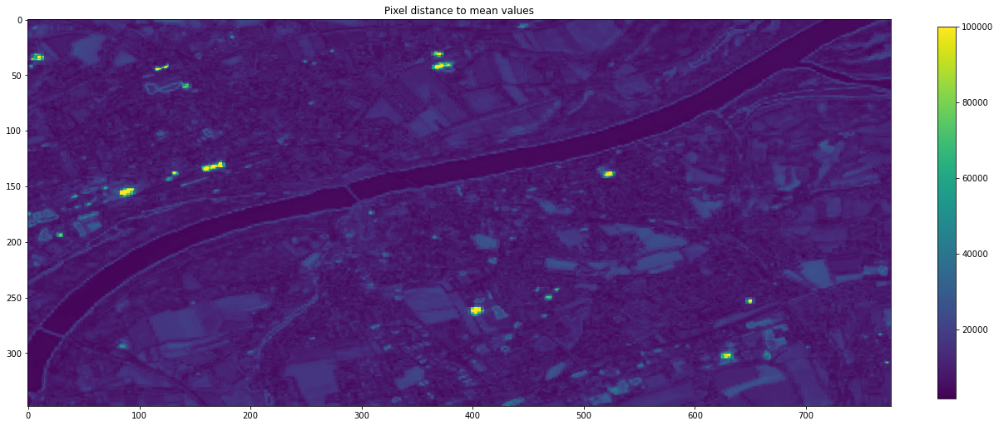

---------------------------------------------------------------------------------------
Cluster: 0
---------------------------------------------------------------------------------------
Min difference: 2159.1238933508594
Pixel 0: (212, 698)
Min difference: 2412.074759949557
Pixel 1: (212, 699)
Min difference: 2495.3091463890933
Pixel 2: (212, 697)
Min difference: 2529.3989306028407
Pixel 3: (80, 23)
Min difference: 2568.616050828705
Pixel 4: (81, 27)
Min difference: 2575.5369049010014
Pixel 5: (237, 321)
Min difference: 2581.3651536658044
Pixel 6: (237, 322)
Min difference: 2587.156361392582
Pixel 7: (138, 237)
Min difference: 2588.205494793884
Pixel 8: (138, 236)
Min difference: 2595.331014360977
Pixel 9: (151, 439)
Min difference: 2597.9142605194256
Pixel 10: (200, 461)
Min difference: 2603.9276977799927
Pixel 11: (80, 24)
Min difference: 2621.962114783728
Pixel 12: (247, 523)
Min difference: 2621.962114783728
Pixel 13: (247, 524)
Min difference: 2636.3762242869725
Pixel 14: (135, 5

Pixel 26: (226, 372)
Min difference: 4507.2350007233
Pixel 27: (335, 476)
Min difference: 4523.982572802208
Pixel 28: (333, 476)
Min difference: 4528.649113014651
Pixel 29: (225, 375)
Min difference: 4531.616639570038
Pixel 30: (332, 123)
Min difference: 4531.616639570038
Pixel 31: (332, 124)
Min difference: 4536.172709372768
Pixel 32: (334, 473)
Min difference: 4545.054348219508
Pixel 33: (226, 373)
Min difference: 4545.958039688743
Pixel 34: (176, 757)
Min difference: 4568.835857406168
Pixel 35: (224, 377)
Min difference: 4586.7474438189
Pixel 36: (337, 467)
Min difference: 4598.008550111297
Pixel 37: (336, 467)
Min difference: 4598.169219236199
Pixel 38: (337, 762)
Min difference: 4610.261100875046
Pixel 39: (264, 726)
Min difference: 4641.376654744545
Pixel 40: (337, 764)
Min difference: 4644.372481755168
Pixel 41: (225, 376)
Min difference: 4651.909329521823
Pixel 42: (40, 206)
Min difference: 4651.909329521823
Pixel 43: (40, 207)
Min difference: 4661.161707855319
Pixel 44: (226, 

Pixel 51: (8, 389)
Min difference: 3556.564806727167
Pixel 52: (23, 766)
Min difference: 3557.1298651309453
Pixel 53: (50, 63)
Min difference: 3560.1262824403766
Pixel 54: (77, 663)
Min difference: 3565.5732897093885
Pixel 55: (303, 31)
Min difference: 3567.502583386383
Pixel 56: (224, 12)
Min difference: 3570.2787984662527
Pixel 57: (24, 767)
Min difference: 3572.582231631309
Pixel 58: (301, 34)
Min difference: 3574.5954964691264
Pixel 59: (120, 305)
Min difference: 3581.0266925252035
Pixel 60: (121, 380)
Min difference: 3583.1656180141235
Pixel 61: (49, 64)
Min difference: 3588.98759382356
Pixel 62: (113, 264)
Min difference: 3598.9492057382267
Pixel 63: (8, 619)
Min difference: 3601.2621433964505
Pixel 64: (269, 209)
Min difference: 3601.2621433964505
Pixel 65: (269, 210)
Min difference: 3615.659866463351
Pixel 66: (25, 767)
Min difference: 3615.659866463351
Pixel 67: (25, 768)
Min difference: 3627.7505588701188
Pixel 68: (138, 632)
Min difference: 3646.966053266614
Pixel 69: (314, 

Pixel 76: (166, 223)
Min difference: 2426.3782833259447
Pixel 77: (29, 668)
Min difference: 2427.6449149419186
Pixel 78: (65, 607)
Min difference: 2432.3589060750255
Pixel 79: (182, 164)
Min difference: 2432.6537756447406
Pixel 80: (51, 630)
Min difference: 2434.8677152261407
Pixel 81: (156, 257)
Min difference: 2434.8677152261407
Pixel 82: (156, 258)
Min difference: 2438.973402414854
Pixel 83: (141, 397)
Min difference: 2439.144754096127
Pixel 84: (103, 508)
Min difference: 2440.953806575765
Pixel 85: (169, 208)
Min difference: 2440.953806575765
Pixel 86: (169, 209)
Min difference: 2443.211777505069
Pixel 87: (195, 125)
Min difference: 2443.211777505069
Pixel 88: (195, 126)
Min difference: 2443.9611331087394
Pixel 89: (159, 308)
Min difference: 2449.3277626537097
Pixel 90: (152, 291)
Min difference: 2452.8935941827344
Pixel 91: (112, 473)
Min difference: 2457.16836477764
Pixel 92: (39, 693)
Min difference: 2459.3042550756095
Pixel 93: (164, 228)
Min difference: 2461.221469225866
Pixel

Pixel 5: (95, 19)
Min difference: 3254.374700878543
Pixel 6: (306, 454)
Min difference: 3262.341954905617
Pixel 7: (289, 522)
Min difference: 3342.9328949343553
Pixel 8: (305, 453)
Min difference: 3380.0829486714847
Pixel 9: (275, 476)
Min difference: 3396.4559229915258
Pixel 10: (123, 587)
Min difference: 3418.562177245479
Pixel 11: (187, 357)
Min difference: 3430.195177363915
Pixel 12: (39, 300)
Min difference: 3439.1357989652106
Pixel 13: (120, 536)
Min difference: 3465.000958157527
Pixel 14: (40, 299)
Min difference: 3465.000958157527
Pixel 15: (40, 300)
Min difference: 3472.1317151718204
Pixel 16: (195, 274)
Min difference: 3481.3102676939407
Pixel 17: (2, 343)
Min difference: 3496.6129599725455
Pixel 18: (39, 302)
Min difference: 3498.0418717172333
Pixel 19: (334, 381)
Min difference: 3519.5230908479934
Pixel 20: (186, 357)
Min difference: 3520.5909528637203
Pixel 21: (228, 594)
Min difference: 3529.4341805730146
Pixel 22: (198, 660)
Min difference: 3533.0317000466575
Pixel 23: (

Min difference: 70954.3799009901
Pixel 35: (60, 140)
Min difference: 71050.62742574255
Pixel 36: (60, 141)
Min difference: 71890.85514851485
Pixel 37: (29, 366)
Min difference: 72541.171980198
Pixel 38: (36, 8)
Min difference: 72923.85514851485
Pixel 39: (29, 367)
Min difference: 73141.99772277227
Pixel 40: (303, 626)
Min difference: 73346.171980198
Pixel 41: (36, 7)
Min difference: 73482.66702970299
Pixel 42: (301, 625)
Min difference: 74109.79831683166
Pixel 43: (61, 142)
Min difference: 74347.07297029703
Pixel 44: (34, 6)
Min difference: 74489.12247524755
Pixel 45: (301, 624)
Min difference: 75969.88742574255
Pixel 46: (31, 368)
Min difference: 76840.77851485147
Pixel 47: (60, 144)
Min difference: 77152.9145544554
Pixel 48: (33, 371)
Min difference: 77312.77851485148
Pixel 49: (60, 143)
Min difference: 78715.73633663362
Pixel 50: (34, 13)
Min difference: 78783.88485148513
Pixel 51: (33, 370)
Min difference: 79648.88485148513
Pixel 52: (33, 369)
Min difference: 80136.10524752474
Pixe

Pixel 65: (62, 109)
Min difference: 14473.087834664158
Pixel 66: (103, 162)
Min difference: 14473.087834664158
Pixel 67: (103, 163)
Min difference: 14473.218882104273
Pixel 68: (179, 21)
Min difference: 14552.783466416156
Pixel 69: (63, 109)
Min difference: 14588.809300140907
Pixel 70: (297, 428)
Min difference: 14717.26538280883
Pixel 71: (291, 630)
Min difference: 14764.357914513857
Pixel 72: (178, 22)
Min difference: 14789.829027712542
Pixel 73: (290, 668)
Min difference: 14854.470173790512
Pixel 74: (62, 114)
Min difference: 14858.85439173321
Pixel 75: (103, 164)
Min difference: 14980.0934711132
Pixel 76: (178, 20)
Min difference: 15091.579614842649
Pixel 77: (228, 391)
Min difference: 15106.604509159231
Pixel 78: (60, 130)
Min difference: 15189.239079379993
Pixel 79: (327, 357)
Min difference: 15221.147487083137
Pixel 80: (291, 672)
Min difference: 15222.06481916393
Pixel 81: (61, 113)
Min difference: 15240.073743541569
Pixel 82: (290, 671)
Min difference: 15279.829027712542
Pixel

In [23]:
plt.figure()
# reshape to only bands
band_axis = np.concatenate(training, axis=0)

# calculate sum of the difference per pixel to the mean of each band in its cluster
represent = []
for c in range(n_clusters):
    # select cluster
    cluster = band_axis*(labels == c)
    # difference to the mean per band
    diff_bands = []
    for b in cluster:
        diff = abs(b - np.full((training.shape[2], training.shape[3]), (np.sum(b)/np.count_nonzero(b)))*(labels == c))
        diff_bands.append(diff)
    diff_bands = np.array(diff_bands)

    # sum of the differences for all bands
    cluster_diff_bands = np.sum(diff_bands, axis=0)
    represent.append(cluster_diff_bands)

# Join all clusters for representation
represent = np.sum(np.array(represent), axis=0)
print(f'Shape: {represent.shape}')

# represent values
plt.figure(figsize=(20,20))
plt.imshow(represent, vmax=100000)
plt.title('Pixel distance to mean values')
plt.colorbar(fraction=0.02)
plt.savefig(f'{figures_filepath}/pixel_representativity.png', format='png', dpi=300)
plt.show()

# select most representative pixels
n_pixels = n_pixels
rep_pix_allCluster = []
for c in range(n_clusters):
    cluster = represent*(labels == c)
    print('---------------------------------------------------------------------------------------')
    print(f'Cluster: {c}')
    print('---------------------------------------------------------------------------------------')
    rep_pix_cluster = []
    for i in range(n_pixels):
        minval = np.nanmin(cluster[np.nonzero(cluster)])
        print(f'Min difference: {minval}')
        pixel = [(ix,iy) for ix, row in enumerate(cluster) for iy, i in enumerate(row) if i == minval][0]
        rep_pix_cluster.append(pixel)
        print(f'Pixel {i}: {pixel}')
        cluster[pixel[0]][pixel [1]] = 0
    print(f'Pixel Locations: {rep_pix_cluster}')
    rep_pix_allCluster.append(rep_pix_cluster)

- **Testing: random**

In [24]:
n_pixels = n_pixels
rand_pix_allCluster = []
for c in range(n_clusters):
    cluster = labels == c
    print('---------------------------------------------------------------------------------------')
    print(f'Cluster: {c}')
    print('---------------------------------------------------------------------------------------')
    rand_pix_cluster = []
    for i in range(n_pixels):
        pixel = tuple(random.choice(allClusters_pixels[c]))
        rand_pix_cluster.append(pixel)
        print(f'Pixel {i}: {pixel}')
    print(f'Pixel Locations: {rand_pix_cluster}')
    rand_pix_allCluster.append(rand_pix_cluster)

---------------------------------------------------------------------------------------
Cluster: 0
---------------------------------------------------------------------------------------
Pixel 0: (123, 106)
Pixel 1: (261, 617)
Pixel 2: (156, 575)
Pixel 3: (272, 316)
Pixel 4: (255, 684)
Pixel 5: (114, 205)
Pixel 6: (105, 123)
Pixel 7: (43, 127)
Pixel 8: (110, 218)
Pixel 9: (74, 307)
Pixel 10: (115, 34)
Pixel 11: (44, 703)
Pixel 12: (154, 107)
Pixel 13: (41, 136)
Pixel 14: (146, 765)
Pixel 15: (285, 268)
Pixel 16: (113, 158)
Pixel 17: (127, 125)
Pixel 18: (177, 681)
Pixel 19: (341, 16)
Pixel 20: (118, 212)
Pixel 21: (103, 67)
Pixel 22: (295, 748)
Pixel 23: (179, 37)
Pixel 24: (118, 199)
Pixel 25: (247, 630)
Pixel 26: (180, 305)
Pixel 27: (122, 262)
Pixel 28: (201, 396)
Pixel 29: (330, 139)
Pixel 30: (273, 637)
Pixel 31: (136, 452)
Pixel 32: (92, 177)
Pixel 33: (231, 776)
Pixel 34: (213, 474)
Pixel 35: (201, 8)
Pixel 36: (163, 526)
Pixel 37: (120, 176)
Pixel 38: (85, 282)
Pixel 39: (214, 

**SHOW TRAINING AND TESTING POSITIONS IN MAP**

In [25]:
'''plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Positions Training Data', fontsize = 70)

# Pixels training positions for the cluster
for sp in range(n_figures):
    cluster = labels==sp
    ax = axs[rows[sp], columns[sp]]
    img = ax.imshow(cluster, cmap='Blues', interpolation='nearest')
    for pixel in rep_pix_allCluster[sp]:
        ax.scatter(pixel[1], pixel[0],color = 'green', marker='*', s=5000, edgecolor='black', linewidth=3)
    for pixel in rand_pix_allCluster[sp]:
        ax.scatter(pixel[1], pixel[0],color = 'red', marker='*', s=5000, edgecolor='black', linewidth=3)
    ax.set_xticks(np.arange(cluster.shape[1]+1, step=100))
    ax.set_xticks(np.arange(cluster.shape[1]+1, step=100))
    ax.set_yticks(np.arange(cluster.shape[0]+1, step=100))
    ax.set_title(f'Cluster {sp}', fontsize=50)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/training_pixel_positions.png', format='png', dpi=300)
plt.show()'''

"plt.figure()\n# Prepare subplots\nn_figures = n_clusters\nn_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar\nn_cols = int(math.ceil(n_figures/n_rows))\nrows=[]\ncolumns = []\nfor row in range(n_rows):\n    for col in range(n_cols):\n        rows.append(row)\n        columns.append(col)\n\n# Subplots and figure title\nfig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))\nfig.suptitle(f'Positions Training Data', fontsize = 70)\n\n# Pixels training positions for the cluster\nfor sp in range(n_figures):\n    cluster = labels==sp\n    ax = axs[rows[sp], columns[sp]]\n    img = ax.imshow(cluster, cmap='Blues', interpolation='nearest')\n    for pixel in rep_pix_allCluster[sp]:\n        ax.scatter(pixel[1], pixel[0],color = 'green', marker='*', s=5000, edgecolor='black', linewidth=3)\n    for pixel in rand_pix_allCluster[sp]:\n        ax.scatter(pixel[1], pixel[0],color = 'red', marker='*', s=5000, edgecolor='black', linewidth=3)\n    ax.set_xti

**GET PIXEL TRAINING DATA**

In [26]:
pixel_training = []
for b in range(len(bands)):
    data = []
    label_data = []
    for cluster in range(n_clusters):
        data_cluster = []
        name = f'Cluster {cluster}'
        label_data.append(name)
        pixels = rep_pix_allCluster[cluster]
        for img in range(training.shape[0]):
            for pixel in pixels:
                pixel = training[img, b, pixel[0], pixel[1]]
                data_cluster.append(pixel)
        data.append(data_cluster)
    pixel_training.append(data)
pixel_training = np.array(pixel_training)
print('bands, clusters, images x pixels')
print(pixel_training.shape)

bands, clusters, images x pixels
(14, 8, 400)


**SHOW TRAINING DATA: BOXPLOTS**

In [27]:
'''plt.figure()

# Prepare subplots
n_figures = len(bands)
n_rows = int(math.ceil((n_figures)**(1/2)))
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Box Plots Training Data', fontsize = 50)

# Represent Data
for sp in range(n_figures):     
    data = pixel_training[sp]
    ax = axs[rows[sp], columns[sp]]
    ax.boxplot(data.transpose())
    ax.set_title(f'Band: {bands[sp]}', fontsize=25)
    ax.set_xlabel('Cluster', fontsize=20)
    ax.set_ylabel('Reflectance', fontsize=20)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=20, width=3)
    plt.sca(axs[rows[sp], columns[sp]])
    plt.xticks(list(range(1,len(label_data)+1)), label_data, rotation='vertical')

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/boxplots_training.png', format='png', dpi=300)
plt.show()'''

"plt.figure()\n\n# Prepare subplots\nn_figures = len(bands)\nn_rows = int(math.ceil((n_figures)**(1/2)))\nn_cols = int(math.ceil(n_figures/n_rows))\nrows=[]\ncolumns = []\nfor row in range(n_rows):\n    for col in range(n_cols):\n        rows.append(row)\n        columns.append(col)\n\n# Subplots and figure title\nfig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))\nfig.suptitle(f'Box Plots Training Data', fontsize = 50)\n\n# Represent Data\nfor sp in range(n_figures):     \n    data = pixel_training[sp]\n    ax = axs[rows[sp], columns[sp]]\n    ax.boxplot(data.transpose())\n    ax.set_title(f'Band: {bands[sp]}', fontsize=25)\n    ax.set_xlabel('Cluster', fontsize=20)\n    ax.set_ylabel('Reflectance', fontsize=20)\n    ax.grid(True, linestyle='-.')\n    ax.tick_params(labelsize=20, width=3)\n    plt.sca(axs[rows[sp], columns[sp]])\n    plt.xticks(list(range(1,len(label_data)+1)), label_data, rotation='vertical')\n\n# delete empty figures\nfor image in range(n_figures, n_rows*n_co

**SHOW TRAINING DATA: BANDS**

In [28]:
'''plt.figure()

# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) 
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Training Pixels Reflectances', fontsize = 60, fontweight="bold")

# Represent Data
for sp in range(n_figures):     
    data = pixel_training[1:-2,sp,:]
    ax = axs[rows[sp], columns[sp]]
    ax.plot(data)
    ax.set_title(f'Cluster: {sp}', fontsize=40)
    ax.set_xlabel('Bands', fontsize=30)
    ax.set_ylabel('Reflectance', fontsize=30)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=30, width=3)
    ax.set_xticks(range(data.shape[0]))
    ax.set_xticklabels(bands[1:-2]);

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# add a comment
textstr = '**Only the most representative pixel of training data is plotted'
plt.gcf().text(0, -0.01, textstr, fontsize=50)

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.93)
plt.savefig(f'{figures_filepath}/bandsShape_training.png', format='png', dpi=300)
plt.show()'''

'plt.figure()\n\n# Prepare subplots\nn_figures = n_clusters\nn_rows = int(math.ceil((n_figures)**(1/2))) \nn_cols = int(math.ceil(n_figures/n_rows))\nrows=[]\ncolumns = []\nfor row in range(n_rows):\n    for col in range(n_cols):\n        rows.append(row)\n        columns.append(col)\n\n# Subplots and figure title\nfig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))\nfig.suptitle(f\'Training Pixels Reflectances\', fontsize = 60, fontweight="bold")\n\n# Represent Data\nfor sp in range(n_figures):     \n    data = pixel_training[1:-2,sp,:]\n    ax = axs[rows[sp], columns[sp]]\n    ax.plot(data)\n    ax.set_title(f\'Cluster: {sp}\', fontsize=40)\n    ax.set_xlabel(\'Bands\', fontsize=30)\n    ax.set_ylabel(\'Reflectance\', fontsize=30)\n    ax.grid(True, linestyle=\'-.\')\n    ax.tick_params(labelsize=30, width=3)\n    ax.set_xticks(range(data.shape[0]))\n    ax.set_xticklabels(bands[1:-2]);\n\n# delete empty figures\nfor image in range(n_figures, n_rows*n_cols):\n    axs[rows[image

**SHOW TRAINING DATA: BANDS ALONG TIME**

In [29]:
'''plt.figure()

# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2)))
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (40,60))
fig.suptitle(f'Training Pixels Reflectances along time', fontsize = 60, fontweight="bold")

# Represent Data

for sp in range(n_figures):     
    data = np.transpose(pixel_training[:-2,sp,:])
    ax = axs[rows[sp], columns[sp]]
    im = ax.plot(data)
    ax.set_title(f'Cluster: {sp}', fontsize=40)
    ax.set_xlabel('DOY', fontsize=30)
    ax.set_ylabel('Reflectance', fontsize=30)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=20, width=3)
    ax.set_xticks(range(data.shape[0]))
    #ax.set_xticklabels(doys, rotation=90);

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()
    
# legend
leg = plt.legend(im, bands[:-2], loc=4, fontsize = 40)

# add a comment
textstr = '**Only the most representative pixel of the training data is plotted'
plt.gcf().text(0, -0.01, textstr, fontsize=50)

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.93)
plt.savefig(f'{figures_filepath}/bandsShapeAlongTime_training.png', format='png', dpi=300)
plt.show()'''

'plt.figure()\n\n# Prepare subplots\nn_figures = n_clusters\nn_rows = int(math.ceil((n_figures)**(1/2)))\nn_cols = int(math.ceil(n_figures/n_rows))\nrows=[]\ncolumns = []\nfor row in range(n_rows):\n    for col in range(n_cols):\n        rows.append(row)\n        columns.append(col)\n\n# Subplots and figure title\nfig, axs = plt.subplots(n_rows, n_cols, figsize= (40,60))\nfig.suptitle(f\'Training Pixels Reflectances along time\', fontsize = 60, fontweight="bold")\n\n# Represent Data\n\nfor sp in range(n_figures):     \n    data = np.transpose(pixel_training[:-2,sp,:])\n    ax = axs[rows[sp], columns[sp]]\n    im = ax.plot(data)\n    ax.set_title(f\'Cluster: {sp}\', fontsize=40)\n    ax.set_xlabel(\'DOY\', fontsize=30)\n    ax.set_ylabel(\'Reflectance\', fontsize=30)\n    ax.grid(True, linestyle=\'-.\')\n    ax.tick_params(labelsize=20, width=3)\n    ax.set_xticks(range(data.shape[0]))\n    #ax.set_xticklabels(doys, rotation=90);\n\n# delete empty figures\nfor image in range(n_figures, 

**GET TESTING DATA**

In [30]:
pixel_testing = []
for b in range(len(bands)):
    data = []
    for cluster in range(n_clusters):
        data_cluster = []
        pixels = rand_pix_allCluster[cluster]
        for img in range(training.shape[0]):
            for pixel in pixels:
                pixel = training[img, b, pixel[0], pixel[1]]
                data_cluster.append(pixel)
        data.append(data_cluster)
    pixel_testing.append(data)
pixel_testing = np.array(pixel_testing)
print('bands, clusters, images x pixels')
print(pixel_testing.shape)

bands, clusters, images x pixels
(14, 8, 400)


# Scale each pixel

- Training pixels: generate scaler and transform

In [31]:
scaler = pp.MinMaxScaler()

pixel_trainingScaled = []    
    
for cluster in range(n_clusters):
    pixel_training_cluster = np.transpose(pixel_training[:, cluster, :]) #images x bands
    pixel_trainingScaled_cluster = scaler.fit_transform(pixel_training_cluster)
    scalers_cluster = os.path.join(model_filepath, f'Scalers/Scaler_{cluster}')
    if not os.path.exists(scalers_cluster):
        os.mkdir(scalers_cluster)
    joblib.dump(scaler, scalers + f'/Scaler_{cluster}/' + '/scale.mod')
    pixel_trainingScaled.append(pixel_trainingScaled_cluster)
    
pixel_trainingScaled = np.array(pixel_trainingScaled)
pixel_trainingScaled.shape # clusters x images x bands

(8, 400, 14)

- Testing pixels: transform

In [32]:
pixel_testingScaled = []    
    
for cluster in range(n_clusters):
    scaler_cluster = joblib.load(scalers + f'/Scaler_{cluster}/scale.mod')
    pixel_testing_cluster = np.transpose(pixel_testing[:, cluster, :]) #images x bands
    pixel_testingScaled_cluster = scaler_cluster.transform(pixel_testing_cluster)
    pixel_testingScaled.append(pixel_testingScaled_cluster)
    
pixel_testingScaled = np.array(pixel_testingScaled)
pixel_testingScaled.shape # clusters x images x bands

(8, 400, 14)

---------------------------------------------------------------------------------------------------------

# Autoencoder

-------------------------------------------------------------------------------------------
                                    CLUSTER 0 --- AUTOENCODER 0
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00041: early stopping
Min error: 0.0018897533882409334
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_0/assets


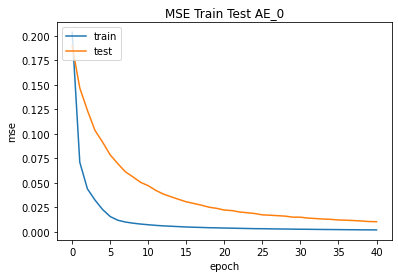

Epoch 00041: early stopping
Min error: 0.0019931502174586058
Epoch 00040: early stopping
Min error: 0.002230491954833269
Epoch 00045: early stopping
Min error: 0.0018439885461702943
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_0/assets


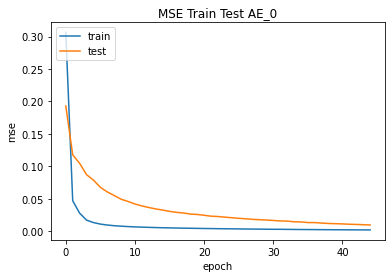

Epoch 00051: early stopping
Min error: 0.0015394394285976887
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_0/assets


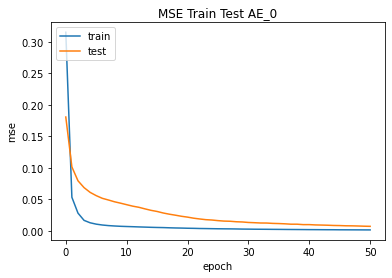

Epoch 00048: early stopping
Min error: 0.0021222822833806276
-------------------------------------------------------------------------------------------
                                    CLUSTER 1 --- AUTOENCODER 1
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00033: early stopping
Min error: 0.00153028080239892
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_1/assets


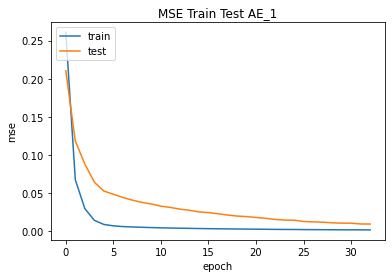

Epoch 00036: early stopping
Min error: 0.0014178735436871648
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_1/assets


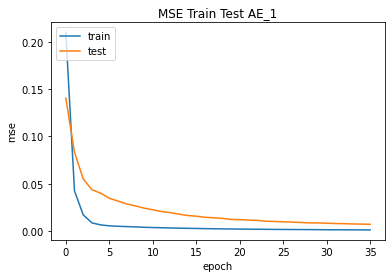

Epoch 00034: early stopping
Min error: 0.0018094949191436172
Epoch 00041: early stopping
Min error: 0.001448808005079627
Epoch 00033: early stopping
Min error: 0.0010651071788743138
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_1/assets


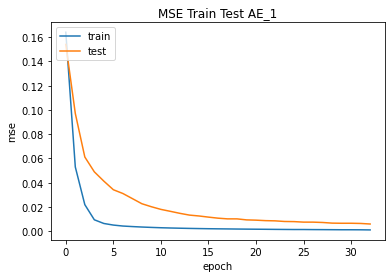

Epoch 00030: early stopping
Min error: 0.0018725325353443623
-------------------------------------------------------------------------------------------
                                    CLUSTER 2 --- AUTOENCODER 2
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00045: early stopping
Min error: 0.001249853172339499
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_2/assets


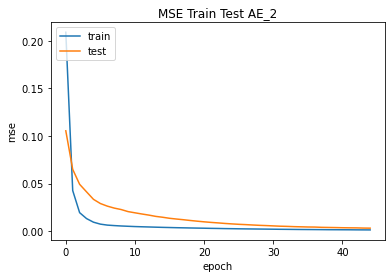

Epoch 00041: early stopping
Min error: 0.0015758165391162038
Epoch 00042: early stopping
Min error: 0.0014817514456808567
Epoch 00042: early stopping
Min error: 0.0013960018986836076
Epoch 00041: early stopping
Min error: 0.0016961852088570595
Epoch 00036: early stopping
Min error: 0.0011438415385782719
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_2/assets


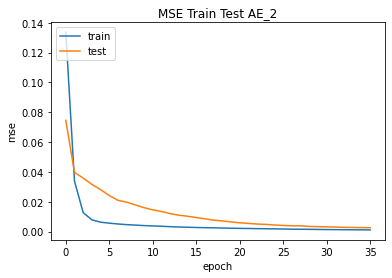

-------------------------------------------------------------------------------------------
                                    CLUSTER 3 --- AUTOENCODER 3
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00030: early stopping
Min error: 0.0011595753021538258
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_3/assets


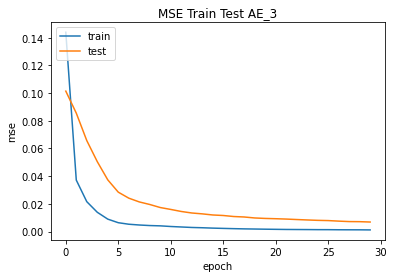

Epoch 00036: early stopping
Min error: 0.0007622806588187814
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_3/assets


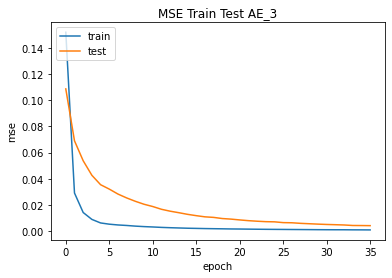

Epoch 00041: early stopping
Min error: 0.0010414993157610297
Epoch 00028: early stopping
Min error: 0.0010191751644015312
Epoch 00028: early stopping
Min error: 0.0011864672414958477
Epoch 00038: early stopping
Min error: 0.0009049061918631196
-------------------------------------------------------------------------------------------
                                    CLUSTER 4 --- AUTOENCODER 4
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00031: early stopping
Min error: 0.0017260685563087463
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_4/assets


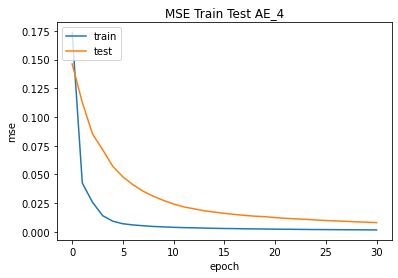

Epoch 00039: early stopping
Min error: 0.0019096817122772336
Epoch 00039: early stopping
Min error: 0.0013190360041335225
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_4/assets


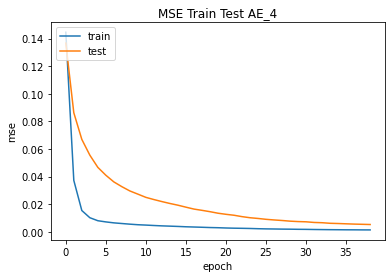

Epoch 00051: early stopping
Min error: 0.001206088811159134
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_4/assets


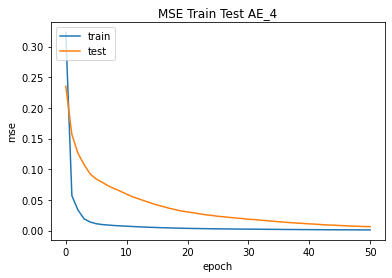

Epoch 00039: early stopping
Min error: 0.001694127800874412
Epoch 00041: early stopping
Min error: 0.001944720628671348
-------------------------------------------------------------------------------------------
                                    CLUSTER 5 --- AUTOENCODER 5
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00041: early stopping
Min error: 0.0014783631777390838
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_5/assets


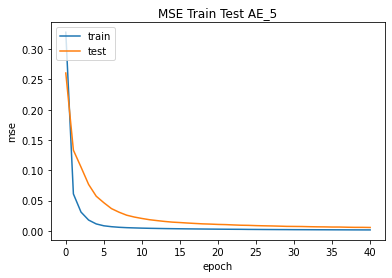

Epoch 00039: early stopping
Min error: 0.0009713933686725795
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_5/assets


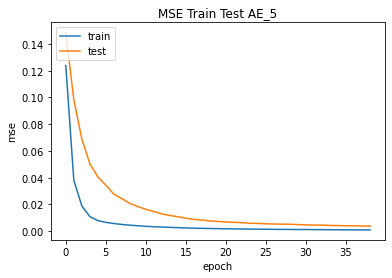

Epoch 00037: early stopping
Min error: 0.001383744878694415
Epoch 00048: early stopping
Min error: 0.000945475825574249
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_5/assets


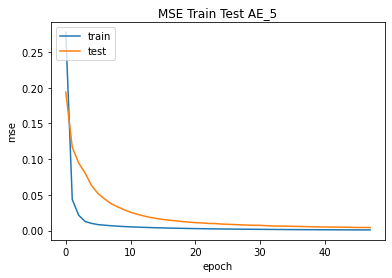

Epoch 00040: early stopping
Min error: 0.0012138518504798412
Epoch 00036: early stopping
Min error: 0.0013296607648953795
-------------------------------------------------------------------------------------------
                                    CLUSTER 6 --- AUTOENCODER 6
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00032: early stopping
Min error: 0.0005316242459230125
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_6/assets


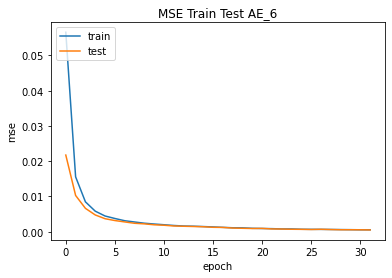

Epoch 00038: early stopping
Min error: 0.000300760380923748
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_6/assets


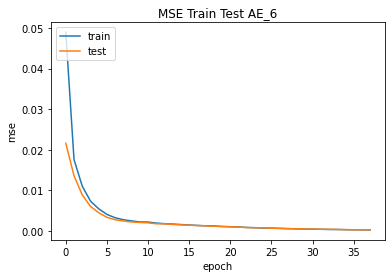

Epoch 00026: early stopping
Min error: 0.0008434467599727213
Epoch 00032: early stopping
Min error: 0.0004367349320091307
Epoch 00036: early stopping
Min error: 0.0005228703957982361
Epoch 00024: early stopping
Min error: 0.0007581079262308776
-------------------------------------------------------------------------------------------
                                    CLUSTER 7 --- AUTOENCODER 7
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00042: early stopping
Min error: 0.0008741462370380759
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_7/assets


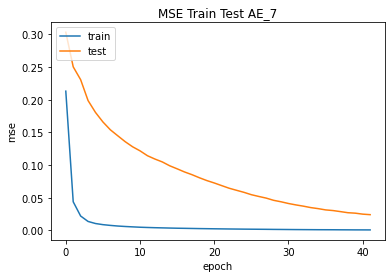

Epoch 00039: early stopping
Min error: 0.0007996952626854181
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/experiment/cloud-reflectances//Branau//basic/Models/Autoencoder_7/assets


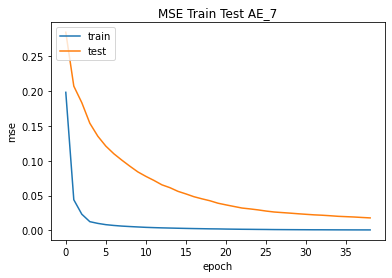

Epoch 00042: early stopping
Min error: 0.0009945505298674107
Epoch 00042: early stopping
Min error: 0.001422843779437244
Epoch 00046: early stopping
Min error: 0.0010982314124703407
Epoch 00039: early stopping
Min error: 0.000836374587379396
Running time AEs --- minutes ----5.289325443903605


In [33]:
# early stopping
es = keras.callbacks.EarlyStopping(monitor = 'mse', mode = 'min', min_delta = 0.001, verbose = 2, patience = 12) 

start = time.time()

for ae in range(n_clusters):

    lowest_error = 100000000

    print(f'''-------------------------------------------------------------------------------------------
                                    CLUSTER {ae} --- AUTOENCODER {ae}
    ------------------------------------------------------------------------------------------------------''')

    ## Create a folder for the AE
    # Model filepaths
    folder = f'Autoencoder_{ae}'
    mf = os.path.join(model_filepath, folder)
    if not os.path.exists(mf):
          os.mkdir(mf)
    # Figures filepaths
    mf2 = os.path.join(figures_filepath, 'Training')
    if not os.path.exists(mf2):
          os.mkdir(mf2)
    mf3 = os.path.join(figures_filepath, 'Error')
    if not os.path.exists(mf3):
          os.mkdir(mf3)
    mf4 = os.path.join(figures_filepath, 'Reflectance')
    if not os.path.exists(mf4):
          os.mkdir(mf4)


    ## Prepare training data
    print('Preparing training data...')

    
    # Data of the selected pixels
    pixel_trainingScaled_cluster = pixel_trainingScaled[ae]
    pixel_testingScaled_cluster = pixel_testingScaled[ae]


    ## Train AE
    print('Training the model...')
    for n in range(6):
        # Create model
        model = Sequential()

        # Create layers
        model.add(Dense(units=n_hidden_neurons, activation='linear', input_dim=len(bands)))
        model.add(Dense(units=len(bands), activation='linear'))

        # Compile model (a traditional default value for the learning rate is 0.1 or 0.01)
        opt = keras.optimizers.Adam(learning_rate=0.01)
        tf.keras.losses.MeanSquaredError(reduction="auto", name="mean_squared_error")
        model.compile(optimizer=opt, loss="mean_squared_error", metrics=['mse'])

        # Train
        X_train = pixel_trainingScaled_cluster
        X_test = pixel_testingScaled_cluster
        history = model.fit(x=X_train, y=X_train,
                            epochs=200,
                            batch_size= None,
                            shuffle=True,
                            validation_data=(X_test,X_test),
                            verbose=0,
                            callbacks=[es])

        # Save best model
        error = min(history.history['mse'])
        print(f'Min error: {error}')

        if error < lowest_error:
            lowest_error = error
            model.save(mf, overwrite=True, include_optimizer=True)
            # Plot train-test curves
            plt.plot(history.history['mse'])
            plt.plot(history.history['val_mse'])
            plt.title(f'MSE Train Test AE_{ae}')
            plt.ylabel('mse')
            plt.xlabel('epoch')
            plt.legend(['train', 'test'], loc='upper left')
            plt.savefig(f'{mf2}/traintestCurvesAE_{ae}.png', format='png', dpi=300)
            plt.show()
        pass

end = time.time()

print(f'Running time AEs --- minutes ----{(end-start)/60}')

# Predictions

In [34]:
# Figures filepaths
mf2 = os.path.join(figures_filepath, 'Training')
mf3 = os.path.join(figures_filepath, 'Error')
mf4 = os.path.join(figures_filepath, 'Reflectance')

# RECONSTRUCT TRAINING DATA

In [112]:
'''scalers = os.path.join(model_filepath, 'Scalers')
reconstruction = []

for ae in list(range(n_clusters)):
    
    # Upload models
    mf = f'{model_filepath}/Autoencoder_{ae}/'
    model = keras.models.load_model(mf)
    scaler_cluster = joblib.load(scalers + f'/Scaler_{cluster}/scale.mod')
    
    # Scale
    trainScaled_AE = scaler_cluster.transform(train_AE)
    
    ## Prediction
    print(f'Predicting autoencoder {ae}...')
    start_p = time.time()
    recScaled_AE = model.predict(x=trainScaled_AE, verbose=1)
    
    # Descale
    reconstruction_AE = scaler_cluster.inverse_transform(recScaled_AE)
    
    # Convert to original shape
    reconstruction_cluster = reconstruction_AE.transpose()
    reconstruction_cluster = reconstruction_cluster.reshape(training.shape[1], training.shape[0], training.shape[2], training.shape[3])
    images = []
    for img in range(training.shape[0]):
        bands_img = []
        for b in range(training.shape[1]):
            band = reconstruction_cluster[b, img, :, :]
            bands_img.append(band)
        images.append(bands_img)
    reconstruction_cluster = np.array(images)
    reconstruction.append(reconstruction_cluster)
    end_p = time.time()
    print(f'Prediction time AE_{ae} ---minutes--- {(end_p-start_p)/60}')

reconstruction = np.array(reconstruction)'''

"scalers = os.path.join(model_filepath, 'Scalers')\nreconstruction = []\n\nfor ae in list(range(n_clusters)):\n    \n    # Upload models\n    mf = f'{model_filepath}/Autoencoder_{ae}/'\n    model = keras.models.load_model(mf)\n    scaler_cluster = joblib.load(scalers + f'/Scaler_{cluster}/scale.mod')\n    \n    # Scale\n    trainScaled_AE = scaler_cluster.transform(train_AE)\n    \n    ## Prediction\n    print(f'Predicting autoencoder {ae}...')\n    start_p = time.time()\n    recScaled_AE = model.predict(x=trainScaled_AE, verbose=1)\n    \n    # Descale\n    reconstruction_AE = scaler_cluster.inverse_transform(recScaled_AE)\n    \n    # Convert to original shape\n    reconstruction_cluster = reconstruction_AE.transpose()\n    reconstruction_cluster = reconstruction_cluster.reshape(training.shape[1], training.shape[0], training.shape[2], training.shape[3])\n    images = []\n    for img in range(training.shape[0]):\n        bands_img = []\n        for b in range(training.shape[1]):\n    

**SHOW PIXEL RECONSTRUCTION (MOST REPRESENTATIVE PIXEL PER CLUSTER)**

In [115]:
'''om matplotlib.cbook import flatten
# Prepare subplots
n_figures = len(bands)
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Show reflectances for each AE
for ae in range(n_clusters):'''
    pint(f'''-------------------------------------------------------------------------------------------
                                    CLUSTER {ae} --- AUTOENCODER {ae}
    ------------------------------------------------------------------------------------------------------''')
    
    '''# Plot reflectances original pixel vs. reconstructed
    reconstruction_cluster = reconstruction[ae]
    pixels = rep_pix_allCluster[ae]
    pixel = pixels[0]
    fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
    rms_l = []
    
    # reflectance bands: B1, B2, B3, B4, B5
    for sp in range(n_figures):
        ori_sublist = []
        pre_sublist = []
        for pixel in pixels:
            ori_pixel = list(training[:,sp, pixel[0], pixel[1]])
            ori_sublist.append(ori_pixel)
            pre_pixel = list(reconstruction_cluster[:,sp, pixel[0], pixel[1]])
            pre_sublist.append(pre_pixel)
        #print(ori_sublist)
        #print(pre_sublist)
        ori = list(flatten(ori_sublist))
        pre = list(flatten(pre_sublist))
        rms = round(mean_squared_error(ori, pre, squared=False),3)
        rms_l.append(rms)
        ax = axs[rows[sp], columns[sp]]
        im = ax.scatter(ori, pre)
        ax.set_xlim(min(min(list(ori)), min(list(pre))), max(max(list(ori)), max(list(pre))))
        ax.set_ylim(min(min(list(ori)), min(list(pre))), max(max(list(ori)), max(list(pre))))
        ax.set_title(f'{bands[sp]} - RMSE = {rms}', fontsize=25)
        ax.set_xlabel('Original', fontsize=20)
        ax.set_ylabel('Predicted', fontsize=20)
        ax.grid(True, linestyle='-.')
        ax.tick_params(labelsize=20, width=3)
    
    # delete empty figures
    for sp in range(n_figures, n_rows*n_cols):
        axs[rows[sp], columns[sp]].set_axis_off()

    plt.title(f'Reflectances Representative Pixel Cluster_{ae}: original vs predicted', fontsize=10)
    plt.tight_layout()
    plt.savefig(f'{mf4}/OriginalvsReconstructed_AE_{ae}.png', format='png', dpi=300)
    plt.show()
    
    # print total RMSE
    print('Sum RMSE all bands...')
    print(f'Total RMSE autoencoder {ae}: {np.sum(np.array(rms_l))}')
    
    # save RMSE
    dict = {'RMSE' : np.sum(np.array(rms_l))}
    f = open( f'{model_filepath}/RMSE_pixel_training_reconstruction.txt', 'w')
    f.write( repr(dict) + '\n' )
    f.close()'''

IndentationError: unexpected indent (<ipython-input-115-e5f7f897fd5f>, line 15)

# PREDICT TEST DATA

In [36]:
scalers = os.path.join(model_filepath, 'Scalers')
prediction = []

for ae in list(range(n_clusters)):
    
    # Upload models
    mf = f'{model_filepath}/Autoencoder_{ae}/'
    model = keras.models.load_model(mf)
    scaler_cluster = joblib.load(scalers + f'/Scaler_{cluster}/scale.mod')
    
    # Scale
    testScaled_AE = scaler_cluster.transform(test_AE)
    
    ## Prediction
    print(f'Predicting autoencoder {ae}...')
    start_p = time.time()
    predScaled_AE = model.predict(x=testScaled_AE, verbose=1)
    
    # Descale
    prediction_AE = scaler_cluster.inverse_transform(predScaled_AE)

    # Convert to original shape
    prediction_cluster = prediction_AE.transpose()
    prediction_cluster = prediction_cluster. reshape(testing.shape[0], testing.shape[1], testing.shape[2])
    prediction.append(prediction_cluster)
    end_p = time.time()
    print(f'Prediction time AE_{ae} ---minutes--- {(end_p-start_p)/60}')

prediction = np.array(prediction)

Predicting autoencoder 0...
8450/8450 [==============================] - 7s 869us/step
Prediction time AE_0 ---minutes--- 0.12599355777104695
Predicting autoencoder 1...
8450/8450 [==============================] - 6s 699us/step
Prediction time AE_1 ---minutes--- 0.10185890197753907
Predicting autoencoder 2...
8450/8450 [==============================] - 7s 814us/step
Prediction time AE_2 ---minutes--- 0.11730516751607259
Predicting autoencoder 3...
8450/8450 [==============================] - 8s 920us/step
Prediction time AE_3 ---minutes--- 0.13225309054056802
Predicting autoencoder 4...
8450/8450 [==============================] - 8s 926us/step
Prediction time AE_4 ---minutes--- 0.13341259558995563
Predicting autoencoder 5...
8450/8450 [==============================] - 8s 938us/step
Prediction time AE_5 ---minutes--- 0.13533732891082764
Predicting autoencoder 6...
8450/8450 [==============================] - 7s 773us/step
Prediction time AE_6 ---minutes--- 0.11226779619852702
Predic

**SHOW PIXEL RECONSTRUCTION (CLOUDY PIXEL)**

-------------------------------------------------------------------------------------------
                                    CLUSTER 0 --- AUTOENCODER 0
    ------------------------------------------------------------------------------------------------------


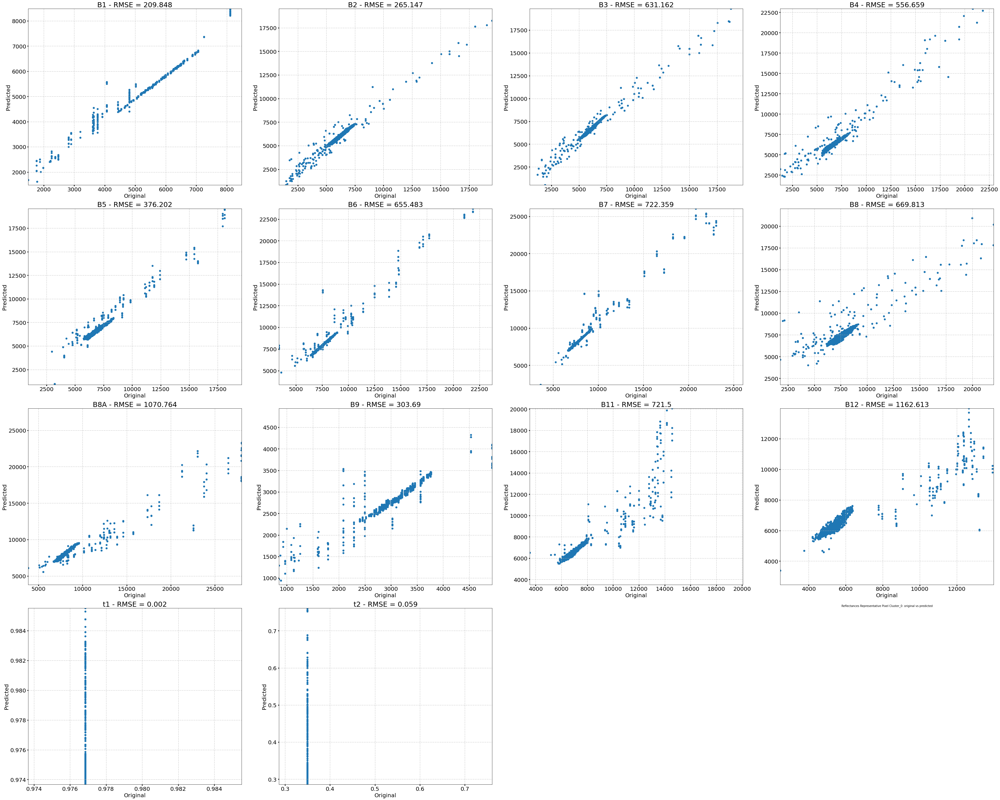

Sum RMSE all bands...
Total RMSE autoencoder 0: 7345.301
-------------------------------------------------------------------------------------------
                                    CLUSTER 1 --- AUTOENCODER 1
    ------------------------------------------------------------------------------------------------------


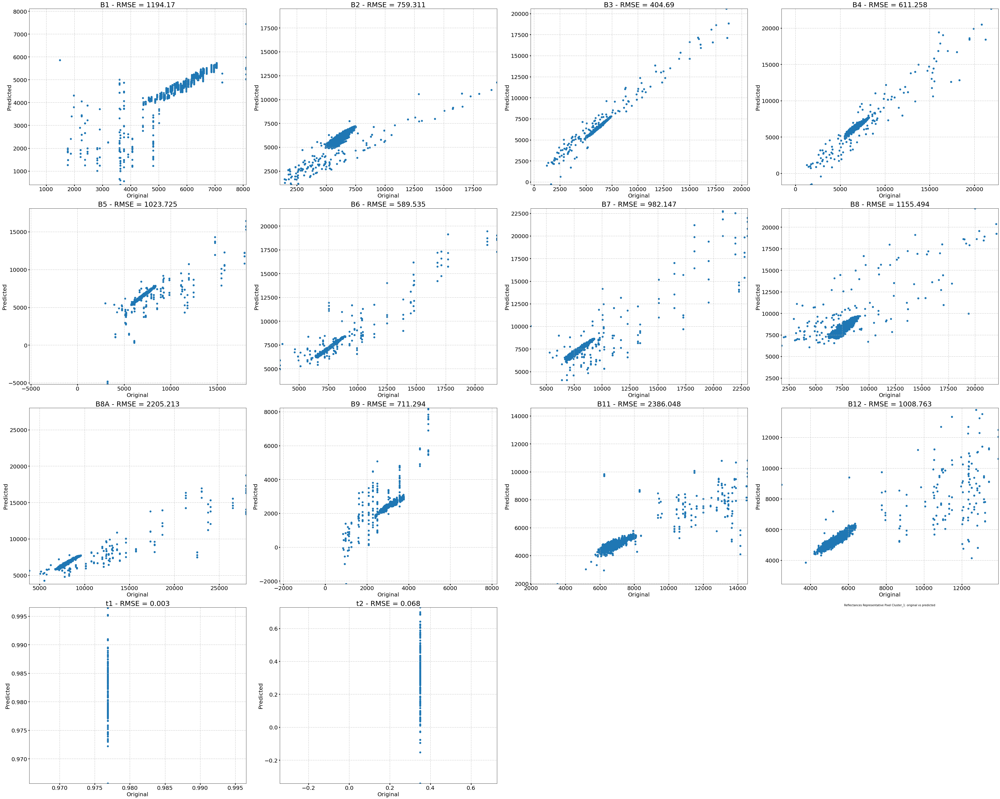

Sum RMSE all bands...
Total RMSE autoencoder 1: 13031.719
-------------------------------------------------------------------------------------------
                                    CLUSTER 2 --- AUTOENCODER 2
    ------------------------------------------------------------------------------------------------------


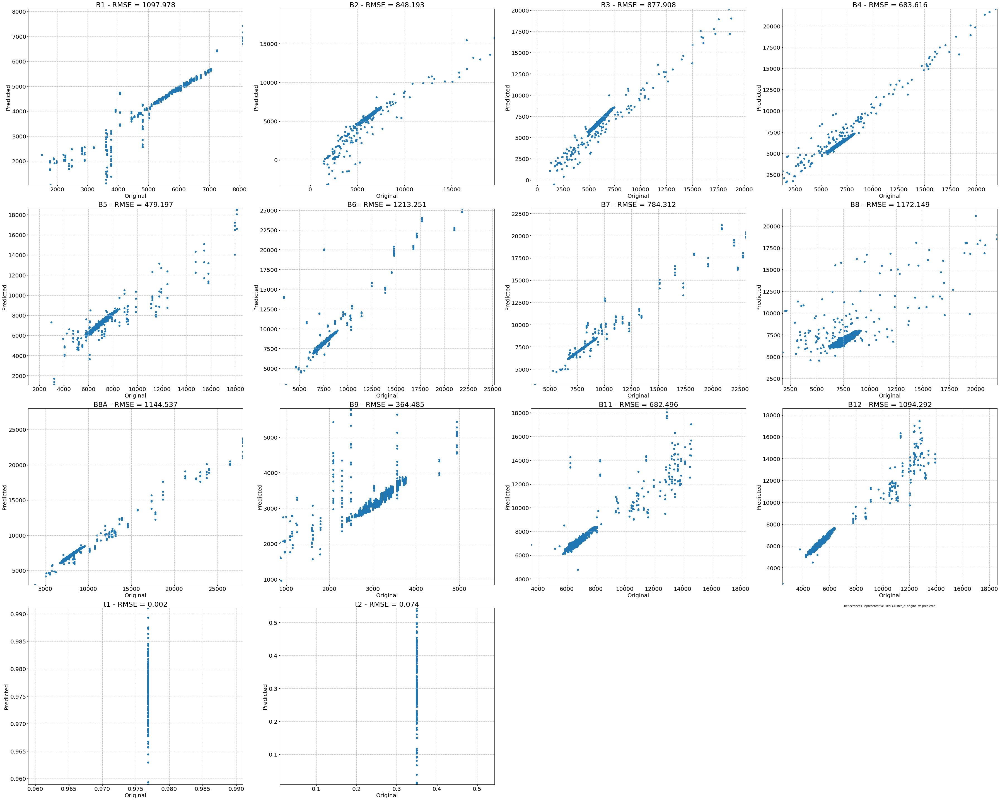

Sum RMSE all bands...
Total RMSE autoencoder 2: 10442.49
-------------------------------------------------------------------------------------------
                                    CLUSTER 3 --- AUTOENCODER 3
    ------------------------------------------------------------------------------------------------------


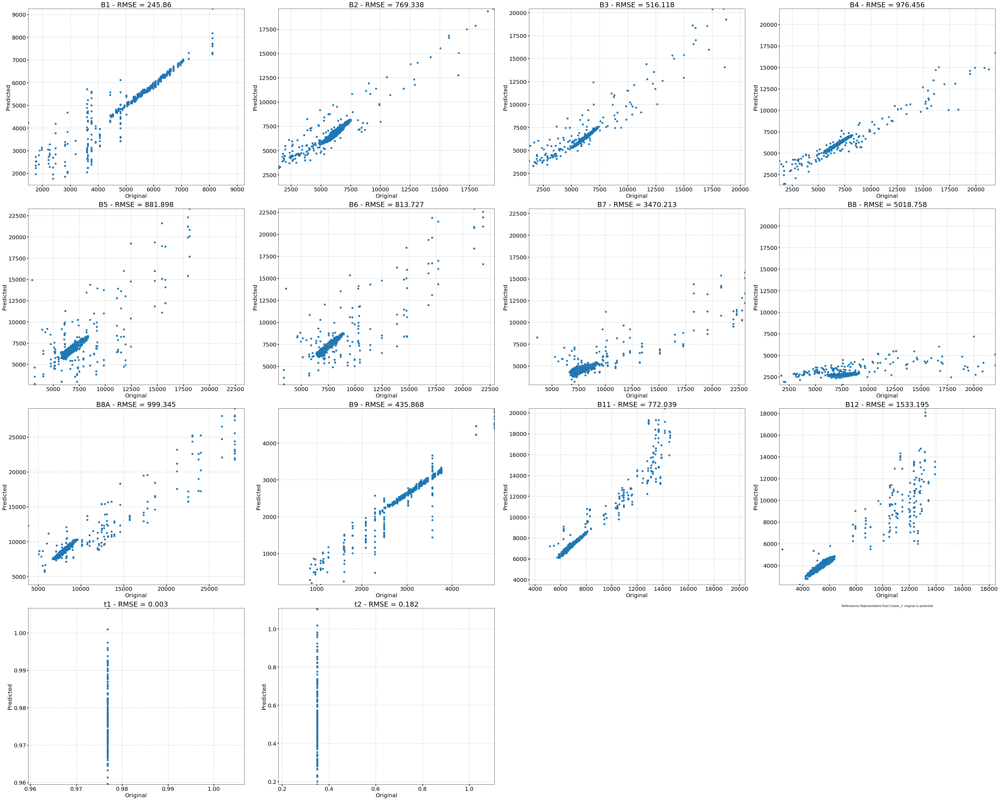

Sum RMSE all bands...
Total RMSE autoencoder 3: 16433.0
-------------------------------------------------------------------------------------------
                                    CLUSTER 4 --- AUTOENCODER 4
    ------------------------------------------------------------------------------------------------------


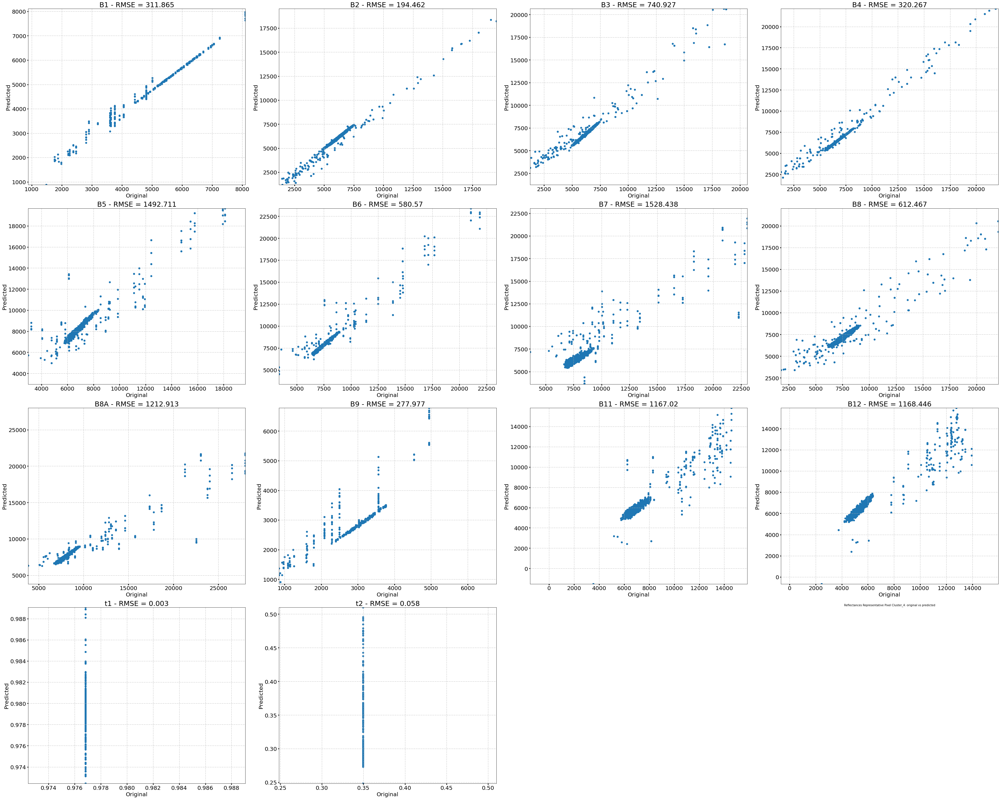

Sum RMSE all bands...
Total RMSE autoencoder 4: 9608.124
-------------------------------------------------------------------------------------------
                                    CLUSTER 5 --- AUTOENCODER 5
    ------------------------------------------------------------------------------------------------------


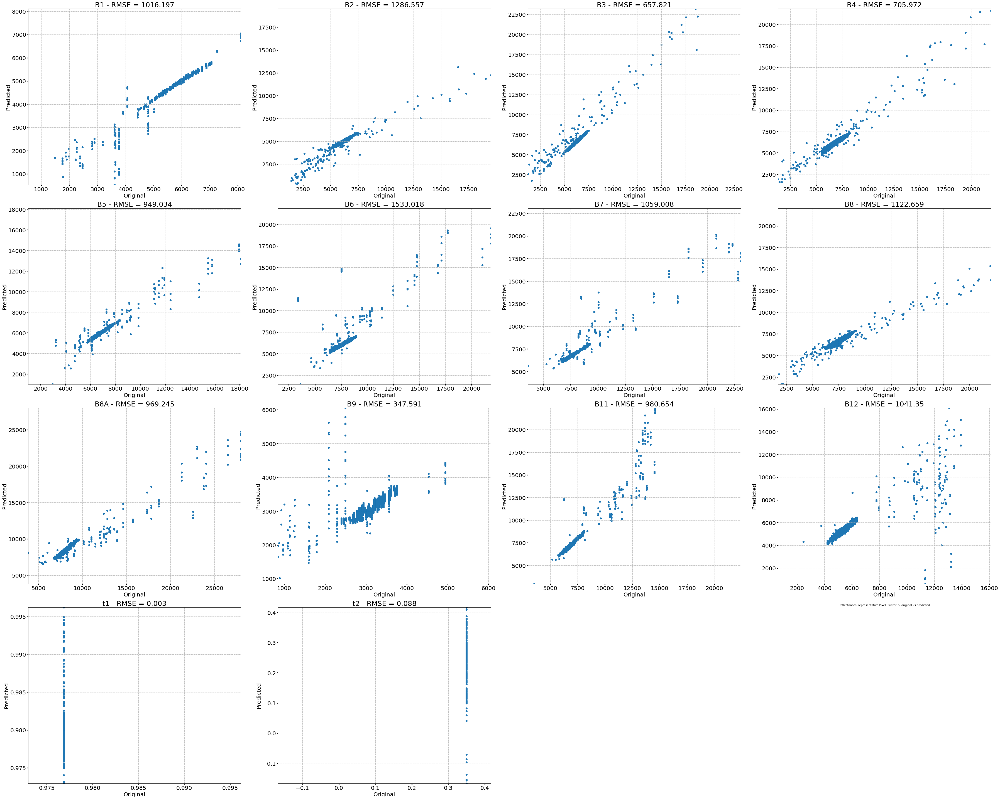

Sum RMSE all bands...
Total RMSE autoencoder 5: 11669.197000000004
-------------------------------------------------------------------------------------------
                                    CLUSTER 6 --- AUTOENCODER 6
    ------------------------------------------------------------------------------------------------------


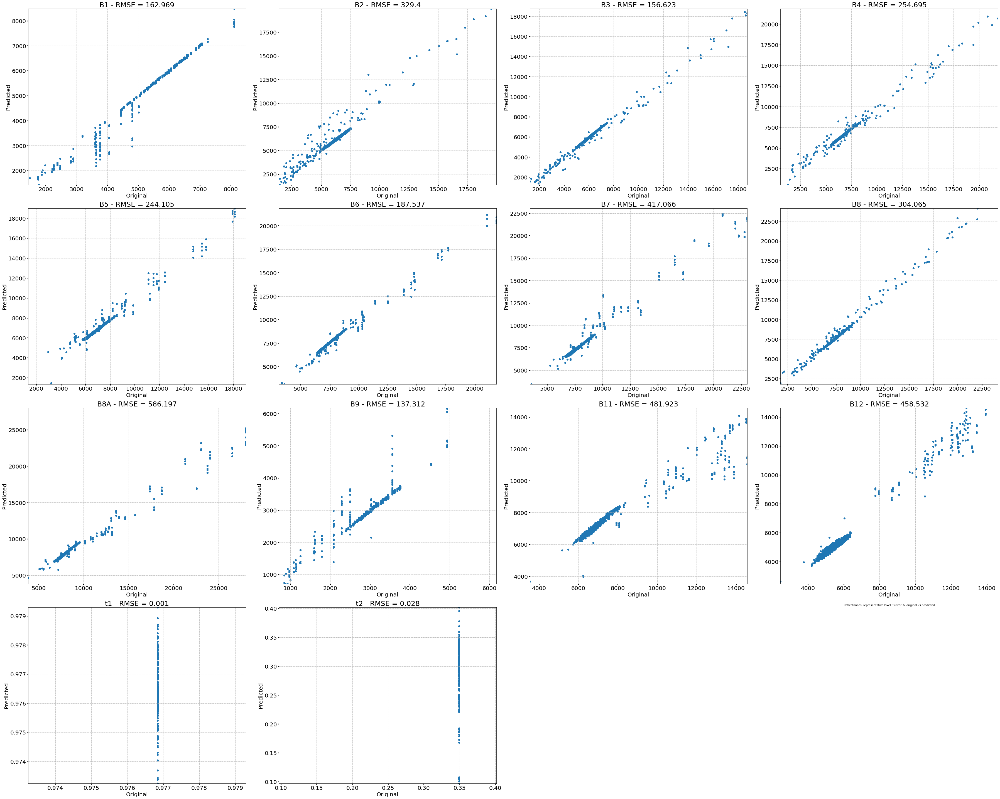

Sum RMSE all bands...
Total RMSE autoencoder 6: 3720.453
-------------------------------------------------------------------------------------------
                                    CLUSTER 7 --- AUTOENCODER 7
    ------------------------------------------------------------------------------------------------------


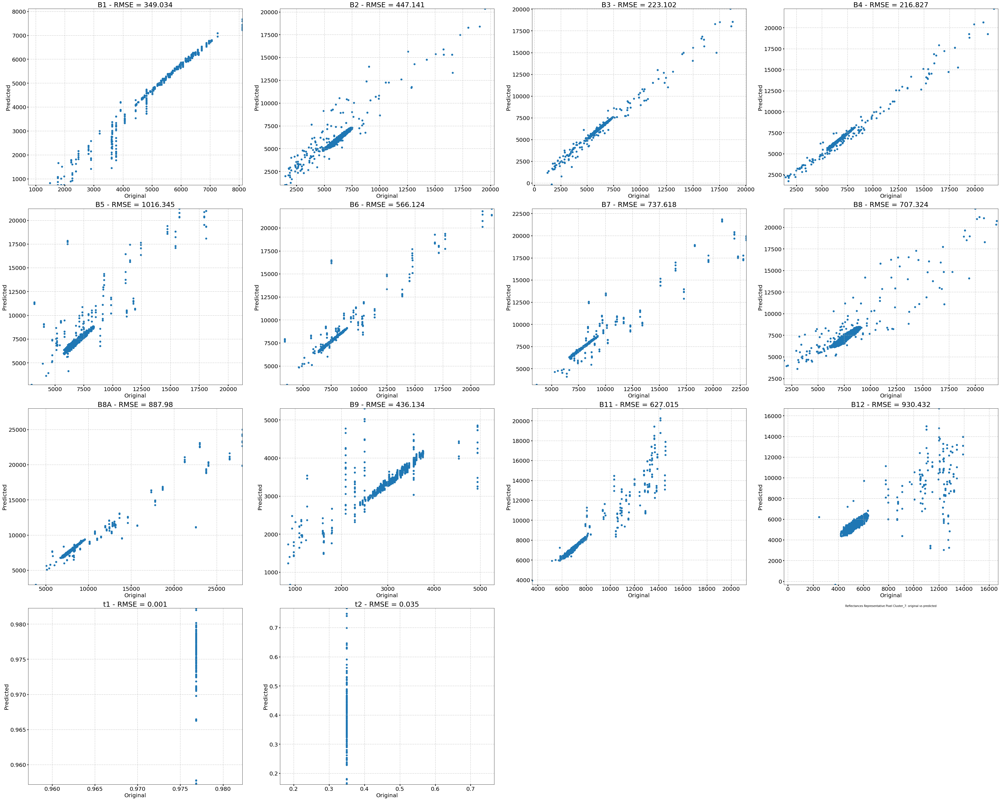

Sum RMSE all bands...
Total RMSE autoencoder 7: 7145.111999999999


In [68]:
from matplotlib.cbook import flatten
# Prepare subplots
n_figures = len(bands)
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Show reflectances for each AE
for ae in range(n_clusters):
    print(f'''-------------------------------------------------------------------------------------------
                                    CLUSTER {ae} --- AUTOENCODER {ae}
    ------------------------------------------------------------------------------------------------------''')
    
    # Plot reflectances original pixel vs. reconstructed
    prediction_cluster = prediction[ae]
    fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
    rms_l = []
    
    # reflectance bands:
    for sp in range(n_figures):
        ori_sublist = []
        pre_sublist = []
        for pixel in cloudy_pixels:
            ori_pixel = testing[sp, pixel[0], pixel[1]]
            ori_sublist.append(ori_pixel)
            pre_pixel = prediction_cluster[sp, pixel[0], pixel[1]]
            pre_sublist.append(pre_pixel)
        #print(ori_sublist)
        #print(pre_sublist)
        ori = list(flatten(ori_sublist))
        pre = list(flatten(pre_sublist))
        rms = round(mean_squared_error(ori, pre, squared=False),3)
        rms_l.append(rms)
        ax = axs[rows[sp], columns[sp]]
        im = ax.scatter(ori, pre)
        ax.set_xlim(min(min(list(ori)), min(list(pre))), max(max(list(ori)), max(list(pre))))
        ax.set_ylim(min(min(list(ori)), min(list(pre))), max(max(list(ori)), max(list(pre))))
        ax.set_title(f'{bands[sp]} - RMSE = {rms}', fontsize=25)
        ax.set_xlabel('Original', fontsize=20)
        ax.set_ylabel('Predicted', fontsize=20)
        ax.grid(True, linestyle='-.')
        ax.tick_params(labelsize=20, width=3)
    
    # delete empty figures
    for sp in range(n_figures, n_rows*n_cols):
        axs[rows[sp], columns[sp]].set_axis_off()

    plt.title(f'Reflectances Representative Pixel Cluster_{ae}: original vs predicted', fontsize=10)
    plt.tight_layout()
    plt.savefig(f'{mf4}/OriginalvsReconstructed_AE_{ae}.png', format='png', dpi=300)
    plt.show()
    
    # print total RMSE
    print('Sum RMSE all bands...')
    print(f'Total RMSE autoencoder {ae}: {np.sum(np.array(rms_l))}')
    
    # save RMSE
    dict = {'RMSE' : np.sum(np.array(rms_l))}
    f = open( f'{model_filepath}/RMSE_pixel_training_reconstruction.txt', 'w')
    f.write( repr(dict) + '\n' )
    f.close()

**Calculate error: RMSE (with scaled values)**

In [63]:
error_list = []
ae=0
for prediction_cluster in prediction:    
    print(f'Calculating error autoencoder {ae}...')
    ae=ae+1
    
    # RMSE y=bands of one image -> predicted vs original + mean of the RMSE between all images
    dif = (prediction_cluster[:-2,:,:]-testing[:-2,:,:])**2
    suma = np.sum(dif, axis = 0)
    div = suma/(testing.shape[0]-2)
    square = div**(1/2)
    error_list.append(square)

error_list = np.array(error_list)

Calculating error autoencoder 0...
Calculating error autoencoder 1...
Calculating error autoencoder 2...
Calculating error autoencoder 3...
Calculating error autoencoder 4...
Calculating error autoencoder 5...
Calculating error autoencoder 6...
Calculating error autoencoder 7...


**Plot error**

In [74]:
##hyperparameters (visualization)
vmin= 0
vmax= 300

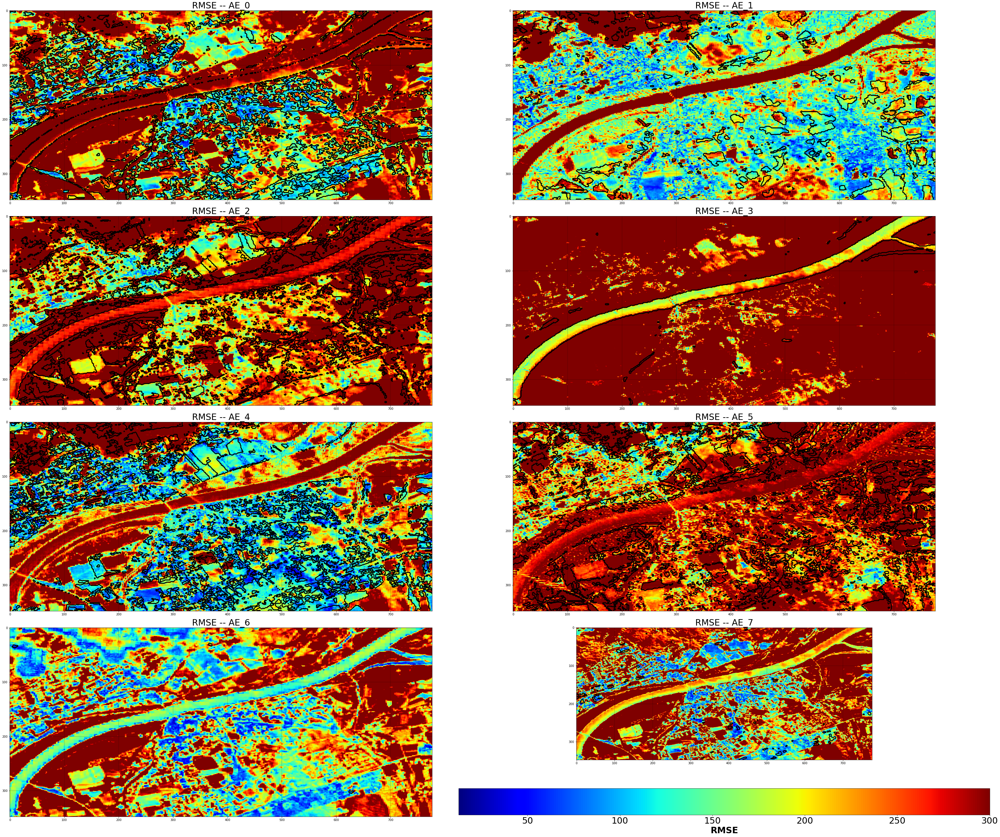

In [99]:
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) +1
n_cols = int(math.ceil(n_figures/n_rows))
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# RMSE in each subplot: plot error matrices
cm = 'jet'
for ae in range(n_figures):
    mean = error_list[ae]
    cluster = labels==ae
    ax = axs[rows[ae], columns[ae]]
    im = ax.imshow(mean, cmap=cm, vmax=vmax)
    ax.contour(cluster, colors='black', linewidths=1.5)
    ax.set_xticks(np.arange(mean.shape[1]+1, step=100))
    ax.set_yticks(np.arange(mean.shape[0]+1, step=100))
    ax.grid(color='black', linewidth=0.3)
    ax.set_title(f'RMSE -- AE_{ae}', fontsize=30)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# colorbar
cb = plt.colorbar(im, orientation="horizontal", pad=0.15)
cb.set_label(label='RMSE', size=30, weight='bold')
cb.ax.tick_params(labelsize=30)

# save
plt.tight_layout()
plt.savefig(f'{mf3}/RMSE_all_AE.png', format='png', dpi=300)
plt.show()

**Min Error of All Autoencoders in AOI**

In [103]:
##hyperparameters (visualization)
vmin1= 100
vmax1= 300

-------------------------------------------------------------------------------------------
                                        MINIMUM VALUE OF ERRORS
    ------------------------------------------------------------------------------------------------------


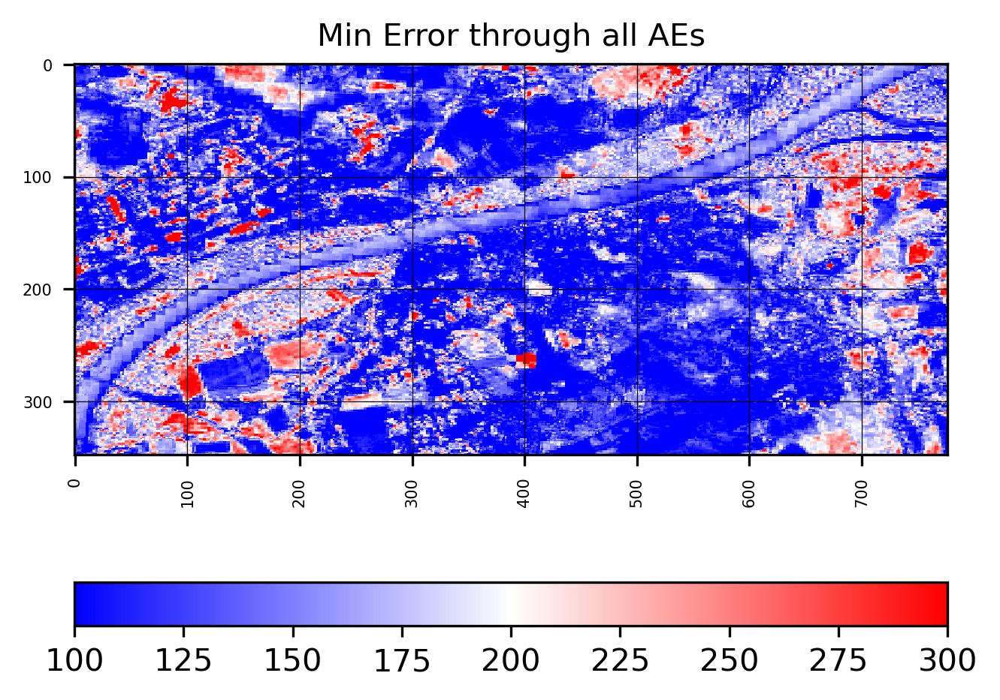

In [104]:
## Min Error of All Autoencoders
print(f'''-------------------------------------------------------------------------------------------
                                        MINIMUM VALUE OF ERRORS
    ------------------------------------------------------------------------------------------------------''')
error = error_list.min(axis=0)
# Plot min error
fig, ax = plt.subplots(figsize=(5,5), dpi=300)
ax = plt.imshow(error, cmap='bwr', interpolation = 'nearest', vmin=vmin1, vmax=vmax1)
plt.xticks(np.arange(error.shape[1]+1, step=100), fontsize=5, rotation=90)
plt.yticks(np.arange(error.shape[0]+1, step=100), fontsize=5, rotation=0)
plt.grid(color='black', linewidth=0.3)
plt.title(f'Min Error through all AEs', fontsize=10)
fig.colorbar(ax, orientation='horizontal')
plt.savefig(f'{mf3}/min_error.png', format='png', dpi=300)
plt.show()

**REPRESENT MIN ERROR BOUNDING CLUSTERS**

<Figure size 432x288 with 0 Axes>

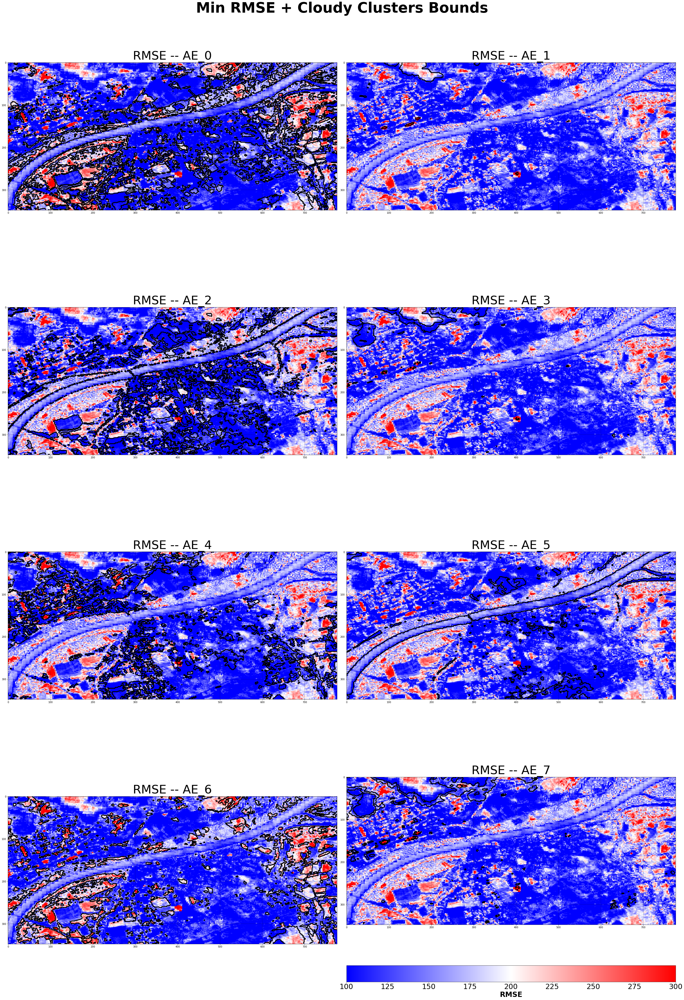

In [120]:
plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = 4 
n_cols = 2
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (40,60))
fig.suptitle(f'Min RMSE + Cloudy Clusters Bounds', fontsize = 60, fontweight="bold")

# RMSE in each subplot: plot error matrices
cm = 'jet'
for sp in range(n_figures):
    cluster = cloudy_labels==sp
    ax = axs[rows[sp], columns[sp]]
    im = ax.imshow(error, cmap='bwr', interpolation = 'nearest',vmin=vmin1, vmax=vmax1)
    ax.contour(cluster, colors='black', linewidths=2)
    ax.set_xticks(np.arange(error.shape[1]+1, step=100))
    ax.set_yticks(np.arange(error.shape[0]+1, step=100))
    ax.grid(color='black', linewidth=0.3)
    ax.set_title(f'RMSE -- AE_{sp}', fontsize=50)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# colorbar
cb = plt.colorbar(im, orientation="horizontal", pad=0.15)
cb.set_label(label='RMSE', size=30, weight='bold')
cb.ax.tick_params(labelsize=30)

# save
fig.subplots_adjust(top=0.9)
plt.tight_layout()
plt.savefig(f'{mf3}/minRMSE_CloudsBounds.png', format='png', dpi=300)
plt.show()

# Reconstruction

**AUTOENCODERS**

In [121]:
# Autoencoder of each pixel
for y in range(testing.shape[1]):
    for x in range(testing.shape[2]):
        for c in range(n_clusters):
            if error[y,x] == error_list[c, y, x]:
                error[y,x] = c
            else:
                pass

<Figure size 432x288 with 0 Axes>

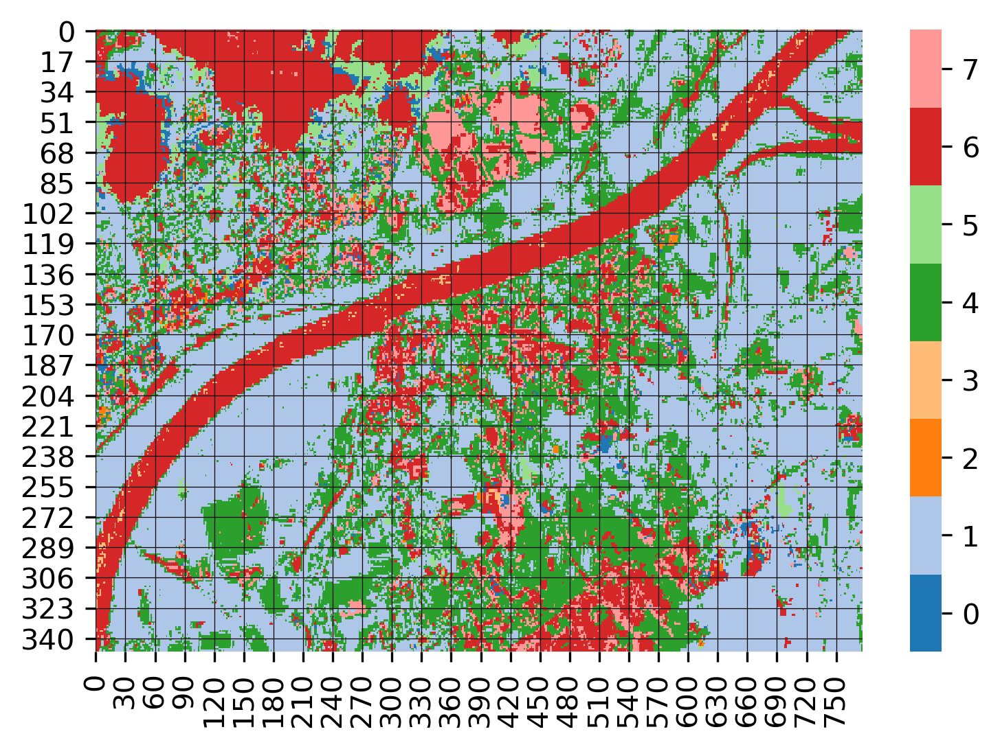

In [122]:
plt.figure()

# discrete colormap (n samples from a given cmap)
cmap = sns.color_palette('tab20', n_clusters) 
fig, ax = plt.subplots(dpi=300) 
ax = sns.heatmap(error, cmap=cmap) 

# modify colorbar:
colorbar = ax.collections[0].colorbar 
r = colorbar.vmax - colorbar.vmin 
colorbar.set_ticks([colorbar.vmin + r / n_clusters * (0.5 + i) for i in range(n_clusters)])
colorbar.set_ticklabels(list(range(n_clusters)))
plt.grid(color='black', linewidth=0.3)

#save and plot
plt.savefig(f'{figures_filepath}/Clusters_Autoencoders.png', format='png', dpi=300)
plt.show()

**TRUE COLOR COMPOSITE**

In [94]:
best_pred = []
for c in range(n_clusters):
    cluster = error == c
    prediction_cluster = prediction[c]
    pred_cluster = cluster * prediction_cluster
    best_pred.append(pred_cluster)
best_pred = np.array(best_pred)
best_pred = np.sum(best_pred, axis = 0)
best_pred.shape

(14, 348, 777)

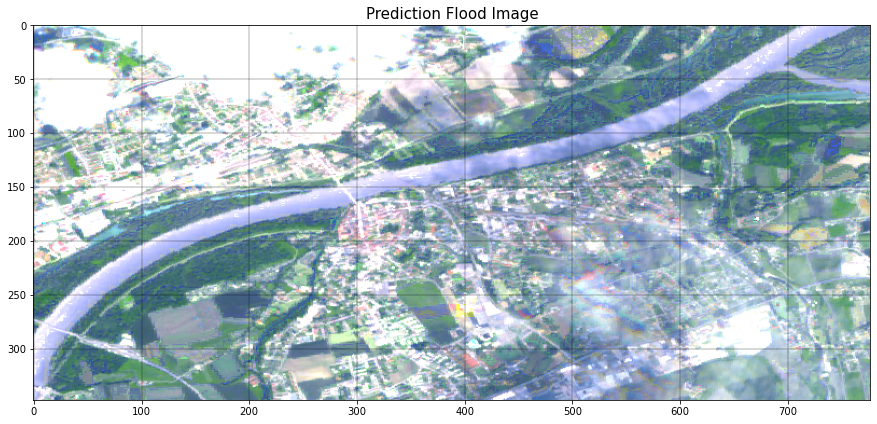

In [95]:
plt.figure(figsize = (15,15))
image = best_pred
img = np.dstack((image[3, ...]/1500, image[2, ...]/1500, image[1, ...]/1500))
img = np.clip(img, 0, 1)
plt.imshow(np.array(img))
plt.grid(color='black', linewidth=0.3)
plt.title(f'Prediction Flood Image', fontsize=15)
plt.savefig(f'{figures_filepath}/reconstruction_TCC.png', format='png', dpi=300)
plt.show()

# End :)